In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import glob

def clear_previous_features(directory):
    # Eliminar todos los archivos .pkl en el directorio especificado
    files = glob.glob(os.path.join(directory, '*.pkl'))
    for f in files:
        try:
            os.remove(f)
            print(f'Eliminado: {f}')
        except Exception as e:
            print(f'No se pudo eliminar {f}. Error: {str(e)}')

# Directorio donde guardas las características
save_dir = "/content/drive/MyDrive/PANCANCER FINAL"

# Llamada a la función para limpiar los archivos previos
clear_previous_features(save_dir)


In [3]:
import os

# Obtener el número de núcleos
num_cores = os.cpu_count()
print(f"Número de núcleos de CPU: {num_cores}")


Número de núcleos de CPU: 12


In [4]:
import torch

if torch.cuda.is_available():
    gpu_name = torch.cuda.get_device_name(0)
    print(f"GPU en uso: {gpu_name}")
    print(f"Memoria total de la GPU: {torch.cuda.get_device_properties(0).total_memory / (1024 ** 3):.2f} GB")
else:
    print("No se encontró una GPU disponible.")


GPU en uso: NVIDIA L4
Memoria total de la GPU: 22.17 GB


In [5]:
!pip install umap-learn shap
!pytorch-lamb

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 35.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 4.4 MB/s eta 0:00:00
/bin/bash: line 1: pytorch-lamb: command not found


In [6]:
import pandas as pd
clinicos = pd.read_pickle('/content/drive/MyDrive/pan_cancer_diner/final/Pan Cancer/Validados/picklesnuevos/meta_sinFPPP.pkl')
clinicos

,Unnamed: 0,data_type,updated_datetime,file_name,md5sum,data_category,experimental_strategy,project,sample_uuid,sample_barcode,...,panel,histology,tissue_site,stage,T,N,M,residual_tumor,new_tumor_events,follow_ups
file_id,,,,,,,,,,,,,,,,,,,,,
9fe7d0f4-866d-490f-b2cb-d9be7da889de,7001,Gene Expression Quantification,2016-05-26T20:51:28.753650-05:00,1db2cfc5-346d-4398-9dd4-8b92435059fd.htseq.cou...,bff9318f04ad067bccc0fbd2d31b45f1,Transcriptome Profiling,RNA-Seq,TCGA,9259e9ee-7279-4b62-8512-509cb705029c,TCGA-DD-AAVP-01A,...,LIHC,Hepatocellular Carcinoma,Liver,Stage I,T1,N0,M0,R0,2.0,1.0
dd74434f-300f-4798-8342-aad31b192e12,8001,Gene Expression Quantification,2016-05-26T21:04:47.187859-05:00,5f4cf592-e135-43ff-9c11-bcba462626d3.htseq.cou...,92cf7b5b7f0a0f5dfa02919c586b72c7,Transcriptome Profiling,RNA-Seq,TCGA,bccb7f9d-8dde-45b7-a50d-6c7233239ceb,TCGA-KK-A7B2-01A,...,PRAD,Prostate Adenocarcinoma Acinar Type,Prostate,NaN,T3a,N1,NaN,R0,2.0,1.0
07db9e9d-059d-4e6c-b483-81517a492b96,1001,Gene Expression Quantification,2016-05-26T21:04:48.015693-05:00,aa4a76e4-5348-479c-8beb-3e4e34e18ce9.htseq.cou...,503fa39eb3a770b869ab0c4297fd0d43,Transcriptome Profiling,RNA-Seq,TCGA,03877fe0-b0d6-4800-be46-b45c70350e48,TCGA-DC-6158-01A,...,READ,Rectal Adenocarcinoma,Rectum,Stage I,T2,N0,M0,R0,3.0,2.0
47ee860a-fd18-48f2-bfe7-4e19391950bd,2001,Gene Expression Quantification,2016-05-26T21:04:48.692729-05:00,0c172934-64ff-44dc-bdba-4c738f5692ea.htseq.cou...,c61b88a22488a1a0d2fb3e7739db0b32,Transcriptome Profiling,RNA-Seq,TCGA,8d3e521b-6df4-4633-bb44-7647ded94130,TCGA-DD-A4NP-01A,...,LIHC,Hepatocellular Carcinoma,Liver,Stage I,T1,N0,M0,R0,3.0,2.0
e322b0e5-458a-4cbf-a64f-9b348e413939,5001,Gene Expression Quantification,2016-05-26T21:04:49.266949-05:00,3025ad45-1d29-4c05-b90f-3d4a348c82c6.htseq.cou...,d279845ef0505630cf5a2ee4b1be5cac,Transcriptome Profiling,RNA-Seq,TCGA,8fef5013-4e57-4043-8770-a56135aeac9b,TCGA-HQ-A5ND-01A,...,BLCA,Muscle invasive urothelial carcinoma (pT2 or a...,Bladder,Stage IV,T3b,N1,M0,NaN,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,3999,Gene Expression Quantification,2016-06-01T23:31:30.205560-05:00,1ef78255-1b5c-42af-aa81-128c1b009114.htseq.cou...,4e139effd7c17a3b6f8c8a2dcf1ba2f5,Transcriptome Profiling,RNA-Seq,TCGA,f03d9b83-a4d7-4e77-abaa-5c3dbee0bcf3,TCGA-BP-4790-01A,...,KIRC,Kidney Clear Cell Renal Carcinoma,Kidney,Stage I,T1a,NX,M0,NaN,2.0,1.0
673a85f3-ba5e-448a-acee-dfec77b5238e,8000,Gene Expression Quantification,2016-06-01T23:31:30.867514-05:00,d07c7238-807f-48b1-bf06-deaa6200f4aa.htseq.cou...,b07dddd077d9db4f26b3e2ae066555c4,Transcriptome Profiling,RNA-Seq,TCGA,d90a2617-bf0b-453f-a483-ceac82781a6c,TCGA-N9-A4Q4-01A,...,UCS,Uterine Carcinosarcoma/ Malignant Mixed Muller...,Uterus,NaN,NaN,NaN,NaN,R0,1.0,0.0
3d93b2ae-7730-4914-af23-ff3554752922,9000,Gene Expression Quantification,2016-06-01T23:31:31.468195-05:00,3c5b65ad-998a-4124-814f-760de89f05d0.htseq.cou...,2046f591b06fa9eafb79d667f7942795,Transcriptome Profiling,RNA-Seq,TCGA,bf8e8426-dc44-40b0-8459-ad1dbaf9ba5a,TCGA-RY-A847-01A,...,LGG,Oligodendroglioma,Central nervous system,NaN,NaN,NaN,NaN,NaN,2.0,1.0


In [7]:
df = pd.read_pickle('/content/drive/MyDrive/pan_cancer_diner/final/Pan Cancer/Validados/picklesnuevos/df_sinFPPP_2.pkl')
df

,5S_rRNA,5_8S_rRNA,7SK,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,...,ZYG11A,ZYG11AP1,ZYG11B,ZYX,ZYXP1,ZZEF1,ZZZ3,hsa-mir-1253,hsa-mir-423,snoZ196
9fe7d0f4-866d-490f-b2cb-d9be7da889de,0,0,79,1055,12,3291,6614,11,0,0,...,5,0,557,3130,0,314,469,0,0,3
dd74434f-300f-4798-8342-aad31b192e12,1,0,1250,8,51,3,24510,55,120,0,...,73,0,963,10619,0,1656,1146,0,0,3
07db9e9d-059d-4e6c-b483-81517a492b96,0,0,41,2,35,1618,21227,29,1,0,...,5,0,2136,13793,0,3667,2641,0,0,3
47ee860a-fd18-48f2-bfe7-4e19391950bd,0,0,111,16482,328,10632,159168,124,1,0,...,66,0,3417,887,0,1822,1891,0,0,1
e322b0e5-458a-4cbf-a64f-9b348e413939,2,0,22,2,0,2,7488,18,1714,0,...,52,0,2155,13427,0,1404,2215,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,3,0,52,14,76,2971,111008,92,6,0,...,28,0,3969,11102,0,4381,2584,0,0,1
673a85f3-ba5e-448a-acee-dfec77b5238e,3,0,169,40,142,4,25243,27,277,0,...,172,0,2717,14657,0,1090,2165,0,0,3
3d93b2ae-7730-4914-af23-ff3554752922,0,1,3961,10,54,3,32550,26,289,1,...,2,0,2568,4216,0,3239,908,0,0,1
85a0b88f-2b89-4117-9e04-b81fad7f2e1b,9,1,1003,90,272,0,331,96,55,0,...,10,0,1611,19604,0,7247,3970,0,0,13


In [8]:
import pandas as pd
from scipy.stats import zscore

# Cargar los datos (asegúrate de que df contiene tu DataFrame)
# df = pd.read_csv("counts.csv")  # Solo si necesitas cargar el archivo

# Aplicar Z-score normalization a todas las filas
df_z_norm = df.apply(zscore, axis=1)

# Mostrar el DataFrame normalizado
print(df_z_norm)


0                                      5S_rRNA  5_8S_rRNA       7SK      A1BG  \
9fe7d0f4-866d-490f-b2cb-d9be7da889de -0.070030  -0.070030 -0.062088  0.036031   
dd74434f-300f-4798-8342-aad31b192e12 -0.131387  -0.131507  0.018754 -0.130546   
07db9e9d-059d-4e6c-b483-81517a492b96 -0.197439  -0.197439 -0.190100 -0.197081   
47ee860a-fd18-48f2-bfe7-4e19391950bd -0.058225  -0.058225 -0.055153  0.397881   
e322b0e5-458a-4cbf-a64f-9b348e413939 -0.173458  -0.173754 -0.170502 -0.173458   
...                                        ...        ...       ...       ...   
62cb41b1-8960-4fa2-8f74-38dd174af004 -0.150401  -0.150758 -0.144578 -0.149094   
673a85f3-ba5e-448a-acee-dfec77b5238e -0.135007  -0.135346 -0.116271 -0.130831   
3d93b2ae-7730-4914-af23-ff3554752922 -0.092573  -0.092495  0.216627 -0.091793   
85a0b88f-2b89-4117-9e04-b81fad7f2e1b -0.132607  -0.133836  0.020155 -0.120158   
a512642f-b720-4efb-a4e9-49b746980809 -0.064709  -0.064791 -0.060806 -0.063123   

0                          

In [9]:
df= df_z_norm

In [10]:
clinicos = clinicos.dropna(subset=['vital'])
clinicos = clinicos.dropna(subset=['panel'])

In [11]:
df['vital'] = clinicos['vital']
df['panel'] = clinicos['panel']

In [12]:
df = df.dropna(subset=['vital'])
df = df.dropna(subset=['panel'])

In [13]:
clinicos['panel'].unique()

array(['LIHC', 'PRAD', 'READ', 'BLCA', 'LGG', 'BRCA', 'UCEC', 'SARC',
       'KIRC', 'PCPG', 'DLBC', 'MESO', 'THYM', 'LUSC', 'LUAD', 'STAD',
       'GBM', 'LAML', 'THCA', 'CESC', 'COAD', 'HNSC', 'UVM', 'SKCM',
       'PAAD', 'OV', 'TGCT', 'KICH', 'ESCA', 'KIRP', 'ACC', 'CHOL', 'UCS'],
      dtype=object)

In [14]:
df

,5S_rRNA,5_8S_rRNA,7SK,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,...,ZYG11B,ZYX,ZYXP1,ZZEF1,ZZZ3,hsa-mir-1253,hsa-mir-423,snoZ196,vital,panel
9fe7d0f4-866d-490f-b2cb-d9be7da889de,-0.070030,-0.070030,-0.062088,0.036031,-0.068824,0.260822,0.594890,-0.068924,-0.070030,-0.070030,...,-0.014034,0.244636,-0.070030,-0.038463,-0.022881,-0.070030,-0.070030,-0.069729,Alive,LIHC
dd74434f-300f-4798-8342-aad31b192e12,-0.131387,-0.131507,0.018754,-0.130546,-0.125377,-0.131147,2.814815,-0.124896,-0.117082,-0.131507,...,-0.015746,1.144992,-0.131507,0.067559,0.006252,-0.131507,-0.131507,-0.131147,Alive,PRAD
07db9e9d-059d-4e6c-b483-81517a492b96,-0.197439,-0.197439,-0.190100,-0.197081,-0.191174,0.092194,3.602343,-0.192248,-0.197260,-0.197439,...,0.184920,2.271605,-0.197439,0.458980,0.275319,-0.197439,-0.197439,-0.196902,Dead,READ
47ee860a-fd18-48f2-bfe7-4e19391950bd,-0.058225,-0.058225,-0.055153,0.397881,-0.049148,0.235994,4.346427,-0.054794,-0.058197,-0.058225,...,0.036333,-0.033679,-0.058225,-0.007805,-0.005896,-0.058225,-0.058225,-0.058197,Alive,LIHC
e322b0e5-458a-4cbf-a64f-9b348e413939,-0.173458,-0.173754,-0.170502,-0.173458,-0.173754,-0.173458,0.933174,-0.171093,0.079621,-0.173754,...,0.144813,1.811118,-0.173754,0.033795,0.153683,-0.173754,-0.173754,-0.173163,Dead,BLCA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,-0.150401,-0.150758,-0.144578,-0.149094,-0.141725,0.202342,13.042433,-0.139824,-0.150045,-0.150758,...,0.320954,1.168704,-0.150758,0.369920,0.156348,-0.150758,-0.150758,-0.150639,Dead,KIRC
673a85f3-ba5e-448a-acee-dfec77b5238e,-0.135007,-0.135346,-0.116271,-0.130831,-0.119319,-0.134894,2.713737,-0.132298,-0.104082,-0.135346,...,0.171312,1.518935,-0.135346,-0.012322,0.109010,-0.135346,-0.135346,-0.135007,Alive,UCS
3d93b2ae-7730-4914-af23-ff3554752922,-0.092573,-0.092495,0.216627,-0.091793,-0.088358,-0.092339,2.448316,-0.090544,-0.070014,-0.092495,...,0.107888,0.236532,-0.092573,0.160267,-0.021694,-0.092573,-0.092573,-0.092495,Alive,LGG
85a0b88f-2b89-4117-9e04-b81fad7f2e1b,-0.132607,-0.133836,0.020155,-0.120158,-0.092188,-0.133990,-0.083121,-0.119236,-0.125537,-0.133990,...,0.113595,2.878835,-0.133990,0.979759,0.476136,-0.133990,-0.133990,-0.131992,Alive,LAML


In [15]:
"""
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import pandas as pd
from torchsummary import summary  # Para imprimir el resumen del modelo

# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
original_indices = df.index.values  # Guardar los índices originales

from sklearn.model_selection import train_test_split

# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de forma estratificada
X_train, X_val, Y_train, Y_val, panels_train, panels_val, indices_train, indices_val = train_test_split(
    X, Y, panels, original_indices, test_size=0.2, stratify=Y, random_state=42
)

# Convertir el estado vital y las etiquetas de dominio a valores numéricos
label_encoder_vital = LabelEncoder()
Y_train = label_encoder_vital.fit_transform(Y_train)
Y_val = label_encoder_vital.transform(Y_val)

label_encoder_panel = LabelEncoder()
panels_train = label_encoder_panel.fit_transform(panels_train)
panels_val = label_encoder_panel.transform(panels_val)

# Convertir los datos a tensores y moverlos al dispositivo
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
panels_train_tensor = torch.tensor(panels_train, dtype=torch.long).to(device)

X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)
panels_val_tensor = torch.tensor(panels_val, dtype=torch.long).to(device)

# Crear datasets y dataloaders
batch_size = 128
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor, panels_train_tensor)
val_dataset = TensorDataset(X_val_tensor, Y_val_tensor, panels_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Definición del modelo DANN mejorado (igual al anterior)
class FeatureExtractor(nn.Module):
    def __init__(self, input_dim):
        super(FeatureExtractor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')

    def forward(self, x, lambda_=1.0):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        return x

class LabelPredictor(nn.Module):
    def __init__(self, input_dim):
        super(LabelPredictor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, 1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = torch.sigmoid(self.fc3(x))
        return x

class DomainClassifier(nn.Module):
    def __init__(self, input_dim, num_domains):
        super(DomainClassifier, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, num_domains)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.fc3(x)
        return x

class DANN(nn.Module):
    def __init__(self, feature_dim, num_domains):
        super(DANN, self).__init__()
        self.feature_extractor = FeatureExtractor(feature_dim)
        self.label_predictor = LabelPredictor(1000)
        self.domain_classifier = DomainClassifier(1000, num_domains)

    def forward(self, x, lambda_=1.0):
        features = self.feature_extractor(x)
        reverse_features = ReverseLayerF.apply(features, lambda_)
        label_output = self.label_predictor(features)
        domain_output = self.domain_classifier(reverse_features)
        return label_output, domain_output, features

class ReverseLayerF(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.lambda_, None

# Parámetro tunable: lambda
lambda_ = 1

# Definir las funciones de pérdida
criterion_label = nn.BCELoss().to(device)
criterion_domain = nn.CrossEntropyLoss().to(device)

# Crear el modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Definir el optimizador AdamW
optimizer = optim.AdamW(
    model.parameters(),
    lr=0.01,  # Tasa de aprendizaje
    betas=(0.9, 0.99),  # Coeficientes beta
    eps=1e-8,  # Valor pequeño para estabilidad numérica
    weight_decay=0.01,  # Regularización L2
    amsgrad=False  # Si deseas usar la variante AMSGrad
)

# Inicializar listas para guardar pérdidas y accuracies
losses_label_train, losses_domain_train, losses_total_train = [], [], []
accuracies_label_train, accuracies_domain_train = [], []

losses_label_val, losses_domain_val, losses_total_val = [], [], []
accuracies_label_val, accuracies_domain_val = [], []

# Función para evaluar en el conjunto de validación
def evaluate_model(model, loader):
    model.eval()
    running_loss_label = 0.0
    running_loss_domain = 0.0
    correct_label = 0
    correct_domain = 0
    total = 0

    with torch.no_grad():
        for inputs, labels, domains in loader:
            inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

            label_preds, domain_preds, _ = model(inputs, lambda_)

            loss_label = criterion_label(label_preds, labels)
            loss_domain = criterion_domain(domain_preds, domains)

            running_loss_label += loss_label.item()
            running_loss_domain += loss_domain.item()

            predicted_label = (label_preds > 0.5).float()
            correct_label += (predicted_label == labels).sum().item()

            _, predicted_domain = torch.max(domain_preds, 1)
            correct_domain += (predicted_domain == domains).sum().item()

            total += labels.size(0)

    return running_loss_label / len(loader), running_loss_domain / len(loader), correct_label / total, correct_domain / total

# Entrenamiento
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    running_loss_label_train = 0.0
    running_loss_domain_train = 0.0
    correct_label_train = 0
    correct_domain_train = 0
    total_train = 0

    for i, (inputs, labels, domains) in enumerate(train_loader):
        inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

        # Forward pass
        label_preds, domain_preds, features = model(inputs, lambda_)

        # Cálculo de pérdidas
        loss_label = criterion_label(label_preds, labels)
        loss_domain = criterion_domain(domain_preds, domains)
        total_loss = loss_label + loss_domain

        # Reseteo de gradientes
        optimizer.zero_grad()

        # Backpropagation
        total_loss.backward()

        # Actualización de los parámetros del modelo
        optimizer.step()

        # Acumulación de pérdidas
        running_loss_label_train += loss_label.item()
        running_loss_domain_train += loss_domain.item()

        # Calcular accuracies
        predicted_label = (label_preds > 0.5).float()
        correct_label_train += (predicted_label == labels).sum().item()

        _, predicted_domain = torch.max(domain_preds, 1)
        correct_domain_train += (predicted_domain == domains).sum().item()

        total_train += labels.size(0)

    # Guardar métricas de entrenamiento
    losses_label_train.append(running_loss_label_train / len(train_loader))
    losses_domain_train.append(running_loss_domain_train / len(train_loader))
    losses_total_train.append((running_loss_label_train + running_loss_domain_train) / len(train_loader))
    accuracies_label_train.append(correct_label_train / total_train)
    accuracies_domain_train.append(correct_domain_train / total_train)

    # Evaluar en validación
    loss_label_val, loss_domain_val, accuracy_label_val, accuracy_domain_val = evaluate_model(model, val_loader)
    losses_label_val.append(loss_label_val)
    losses_domain_val.append(loss_domain_val)
    losses_total_val.append(loss_label_val + loss_domain_val)
    accuracies_label_val.append(accuracy_label_val)
    accuracies_domain_val.append(accuracy_domain_val)

    # Imprimir métricas por época
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss Label: {losses_label_train[-1]:.4f}, Train Loss Domain: {losses_domain_train[-1]:.4f}, Train Total Loss: {losses_total_train[-1]:.4f}')
    print(f'Validation Loss Label: {losses_label_val[-1]:.4f}, Validation Loss Domain: {losses_domain_val[-1]:.4f}, Validation Total Loss: {losses_total_val[-1]:.4f}')
    print(f'Train Label Accuracy: {accuracies_label_train[-1]:.4f}, Train Domain Accuracy: {accuracies_domain_train[-1]:.4f}')
    print(f'Validation Label Accuracy: {accuracies_label_val[-1]:.4f}, Validation Domain Accuracy: {accuracies_domain_val[-1]:.4f}')

# Graficar las métricas
plt.figure(figsize=(14, 7))

# Pérdidas
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs+1), losses_label_train, label='Train Loss Label',color='#37ff00')
plt.plot(range(1, num_epochs+1), losses_domain_train, label='Train Loss Domain', color= '#ff0000')
#plt.plot(range(1, num_epochs+1), losses_total_train, label='Train Total Loss')
plt.plot(range(1, num_epochs+1), losses_label_val, label='Validation Loss Label',color='#c1ffb0')
plt.plot(range(1, num_epochs+1), losses_domain_val, label='Validation Loss Domain', color = '#f7adad')
#plt.plot(range(1, num_epochs+1), losses_total_val, label='Validation Total Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Train/Validation Loss over epochs')
plt.legend()

# Accuracies
plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs+1), accuracies_label_train, label='Train Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_train, label='Train Domain Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_label_val, label='Validation Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_val, label='Validation Domain Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Train/Validation Accuracy over epochs')
plt.legend()

plt.tight_layout()
plt.show()
"""

'\nimport os\nimport torch\nimport torch.nn as nn\nimport torch.optim as optim\nimport torch.nn.functional as F\nfrom sklearn.preprocessing import LabelEncoder\nfrom torch.utils.data import DataLoader, TensorDataset\nimport numpy as np\nimport umap\nimport seaborn as sns\nimport matplotlib.pyplot as plt\nimport pickle\nimport pandas as pd\nfrom torchsummary import summary  # Para imprimir el resumen del modelo\n\n# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU\ndevice = torch.device("cuda" if torch.cuda.is_available() else "cpu")\nprint(f"Usando dispositivo: {device}")\n\n# Preparar los datos\nX = df.iloc[:, :-2].values  # Datos de miRNAs\nY = df[\'vital\'].values  # Estado vital\npanels = df[\'panel\'].values  # Etiquetas del dominio (paneles)\noriginal_indices = df.index.values  # Guardar los índices originales\n\nfrom sklearn.model_selection import train_test_split\n\n# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de for

Usando dispositivo: cuda
Epoch [1/100]
--------------------------------------------------
Train Loss Label: 0.8513
Train Loss Domain: 1.7222
Train Total Loss: 2.5735

Validation Loss Label: 0.5663
Validation Loss Domain: 1.0601
Validation Total Loss: 1.6264

Train Label Accuracy: 0.6590
Train Domain Accuracy: 0.5779

Validation Label Accuracy: 0.7157
Validation Domain Accuracy: 0.6914
--------------------------------------------------
Modelo guardado: model_checkpoints/model_epoch_1.pth
Epoch [2/100]
--------------------------------------------------
Train Loss Label: 0.5529
Train Loss Domain: 1.1016
Train Total Loss: 1.6545

Validation Loss Label: 0.5996
Validation Loss Domain: 1.4382
Validation Total Loss: 2.0378

Train Label Accuracy: 0.7146
Train Domain Accuracy: 0.6767

Validation Label Accuracy: 0.7235
Validation Domain Accuracy: 0.6118
--------------------------------------------------
Modelo guardado: model_checkpoints/model_epoch_2.pth
Epoch [3/100]
---------------------------

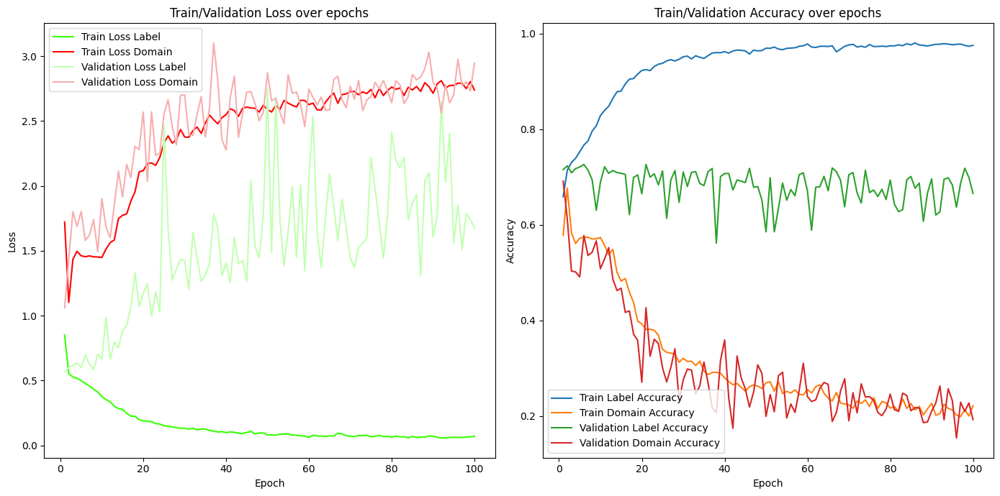

In [16]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import pandas as pd
from torchsummary import summary  # Para imprimir el resumen del modelo

# Configurar el dispositivo para GPU si está disponible, de lo contrario, usar CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

# Preparar los datos
X = df.iloc[:, :-2].values  # Datos de miRNAs
Y = df['vital'].values  # Estado vital
panels = df['panel'].values  # Etiquetas del dominio (paneles)
original_indices = df.index.values  # Guardar los índices originales

from sklearn.model_selection import train_test_split

# Dividir los datos en conjuntos de entrenamiento (80%) y validación (20%) de forma estratificada
X_train, X_val, Y_train, Y_val, panels_train, panels_val, indices_train, indices_val = train_test_split(
    X, Y, panels, original_indices, test_size=0.2, stratify=Y, random_state=42
)

# Convertir el estado vital y las etiquetas de dominio a valores numéricos
label_encoder_vital = LabelEncoder()
Y_train = label_encoder_vital.fit_transform(Y_train)
Y_val = label_encoder_vital.transform(Y_val)

label_encoder_panel = LabelEncoder()
panels_train = label_encoder_panel.fit_transform(panels_train)
panels_val = label_encoder_panel.transform(panels_val)

# Convertir los datos a tensores y moverlos al dispositivo
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
panels_train_tensor = torch.tensor(panels_train, dtype=torch.long).to(device)

X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)
panels_val_tensor = torch.tensor(panels_val, dtype=torch.long).to(device)

# Crear datasets y dataloaders
batch_size = 128
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor, panels_train_tensor)
val_dataset = TensorDataset(X_val_tensor, Y_val_tensor, panels_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Definición del modelo DANN mejorado (igual al anterior)
class FeatureExtractor(nn.Module):
    def __init__(self, input_dim):
        super(FeatureExtractor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')

    def forward(self, x, lambda_=1.0):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        return x

class LabelPredictor(nn.Module):
    def __init__(self, input_dim):
        super(LabelPredictor, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, 1)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = torch.sigmoid(self.fc3(x))
        return x

class DomainClassifier(nn.Module):
    def __init__(self, input_dim, num_domains):
        super(DomainClassifier, self).__init__()
        self.fc1 = nn.Linear(input_dim, 1000)
        self.bn1 = nn.BatchNorm1d(1000)
        self.dropout1 = nn.Dropout(0.1)
        self.fc2 = nn.Linear(1000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)
        self.dropout2 = nn.Dropout(0.1)
        self.fc3 = nn.Linear(1000, num_domains)

        # Inicialización de He
        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='leaky_relu')
        nn.init.kaiming_normal_(self.fc3.weight, nonlinearity='leaky_relu')

    def forward(self, x):
        x = F.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout1(x)
        x = F.leaky_relu(self.bn2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.fc3(x)
        return x

class DANN(nn.Module):
    def __init__(self, feature_dim, num_domains):
        super(DANN, self).__init__()
        self.feature_extractor = FeatureExtractor(feature_dim)
        self.label_predictor = LabelPredictor(1000)
        self.domain_classifier = DomainClassifier(1000, num_domains)

    def forward(self, x, lambda_=1.0):
        features = self.feature_extractor(x)
        reverse_features = ReverseLayerF.apply(features, lambda_)
        label_output = self.label_predictor(features)
        domain_output = self.domain_classifier(reverse_features)
        return label_output, domain_output, features

class ReverseLayerF(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.lambda_, None









# Parámetro tunable: lambda
lambda_ = 0.1






# Definir las funciones de pérdida
criterion_label = nn.BCELoss().to(device)
criterion_domain = nn.CrossEntropyLoss().to(device)

# Crear el modelo
input_dim = X.shape[1]
num_domains = len(label_encoder_panel.classes_)
model = DANN(input_dim, num_domains).to(device)

# Definir el optimizador AdamW
optimizer = optim.AdamW(
    model.parameters(),
    lr=0.01,  # Tasa de aprendizaje
    betas=(0.9, 0.99),  # Coeficientes beta
    eps=1e-8,  # Valor pequeño para estabilidad numérica
    weight_decay=0.01,  # Regularización L2
    amsgrad=False  # Si deseas usar la variante AMSGrad
)

# Crear una carpeta para guardar los modelos si no existe
model_dir = 'model_checkpoints'
os.makedirs(model_dir, exist_ok=True)

# Inicializar listas para guardar pérdidas y accuracies
losses_label_train, losses_domain_train, losses_total_train = [], [], []
accuracies_label_train, accuracies_domain_train = [], []

losses_label_val, losses_domain_val, losses_total_val = [], [], []
accuracies_label_val, accuracies_domain_val = [], []

# Función para evaluar en el conjunto de validación
def evaluate_model(model, loader):
    model.eval()
    running_loss_label = 0.0
    running_loss_domain = 0.0
    correct_label = 0
    correct_domain = 0
    total = 0

    with torch.no_grad():
        for inputs, labels, domains in loader:
            inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

            label_preds, domain_preds, _ = model(inputs, lambda_)

            loss_label = criterion_label(label_preds, labels)
            loss_domain = criterion_domain(domain_preds, domains)

            running_loss_label += loss_label.item()
            running_loss_domain += loss_domain.item()

            predicted_label = (label_preds > 0.5).float()
            correct_label += (predicted_label == labels).sum().item()

            _, predicted_domain = torch.max(domain_preds, 1)
            correct_domain += (predicted_domain == domains).sum().item()

            total += labels.size(0)

    return running_loss_label / len(loader), running_loss_domain / len(loader), correct_label / total, correct_domain / total

# Entrenamiento
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    running_loss_label_train = 0.0
    running_loss_domain_train = 0.0
    correct_label_train = 0
    correct_domain_train = 0
    total_train = 0

    for i, (inputs, labels, domains) in enumerate(train_loader):
        inputs, labels, domains = inputs.to(device), labels.to(device), domains.to(device)

        # Forward pass
        label_preds, domain_preds, features = model(inputs, lambda_)

        # Cálculo de pérdidas
        loss_label = criterion_label(label_preds, labels)
        loss_domain = criterion_domain(domain_preds, domains)
        total_loss = loss_label + loss_domain

        # Reseteo de gradientes
        optimizer.zero_grad()

        # Backpropagation
        total_loss.backward()

        # Actualización de los parámetros del modelo
        optimizer.step()

        # Acumulación de pérdidas
        running_loss_label_train += loss_label.item()
        running_loss_domain_train += loss_domain.item()

        # Calcular accuracies
        predicted_label = (label_preds > 0.5).float()
        correct_label_train += (predicted_label == labels).sum().item()

        _, predicted_domain = torch.max(domain_preds, 1)
        correct_domain_train += (predicted_domain == domains).sum().item()

        total_train += labels.size(0)

    # Guardar métricas de entrenamiento
    losses_label_train.append(running_loss_label_train / len(train_loader))
    losses_domain_train.append(running_loss_domain_train / len(train_loader))
    losses_total_train.append((running_loss_label_train + running_loss_domain_train) / len(train_loader))
    accuracies_label_train.append(correct_label_train / total_train)
    accuracies_domain_train.append(correct_domain_train / total_train)

    # Evaluar en validación
    loss_label_val, loss_domain_val, accuracy_label_val, accuracy_domain_val = evaluate_model(model, val_loader)
    losses_label_val.append(loss_label_val)
    losses_domain_val.append(loss_domain_val)
    losses_total_val.append(loss_label_val + loss_domain_val)
    accuracies_label_val.append(accuracy_label_val)
    accuracies_domain_val.append(accuracy_domain_val)

    # Imprimir métricas por época
    print(f'Epoch [{epoch+1}/{num_epochs}]')
    print('-' * 50)
    print(f'Train Loss Label: {losses_label_train[-1]:.4f}')
    print(f'Train Loss Domain: {losses_domain_train[-1]:.4f}')
    print(f'Train Total Loss: {losses_total_train[-1]:.4f}')
    print()
    print(f'Validation Loss Label: {losses_label_val[-1]:.4f}')
    print(f'Validation Loss Domain: {losses_domain_val[-1]:.4f}')
    print(f'Validation Total Loss: {losses_total_val[-1]:.4f}')
    print()
    print(f'Train Label Accuracy: {accuracies_label_train[-1]:.4f}')
    print(f'Train Domain Accuracy: {accuracies_domain_train[-1]:.4f}')
    print()
    print(f'Validation Label Accuracy: {accuracies_label_val[-1]:.4f}')
    print(f'Validation Domain Accuracy: {accuracies_domain_val[-1]:.4f}')
    print('-' * 50)


    # Guardar el modelo de la iteración actual
    model_path = os.path.join(model_dir, f'model_epoch_{epoch+1}.pth')
    torch.save(model.state_dict(), model_path)
    print(f'Modelo guardado: {model_path}')

# Graficar las métricas
plt.figure(figsize=(14, 7))

# Pérdidas
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs+1), losses_label_train, label='Train Loss Label', color='#37ff00')
plt.plot(range(1, num_epochs+1), losses_domain_train, label='Train Loss Domain', color= '#ff0000')
plt.plot(range(1, num_epochs+1), losses_label_val, label='Validation Loss Label', color='#c1ffb0')
plt.plot(range(1, num_epochs+1), losses_domain_val, label='Validation Loss Domain', color = '#f7adad')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Train/Validation Loss over epochs')
plt.legend()

# Accuracies
plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs+1), accuracies_label_train, label='Train Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_train, label='Train Domain Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_label_val, label='Validation Label Accuracy')
plt.plot(range(1, num_epochs+1), accuracies_domain_val, label='Validation Domain Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Train/Validation Accuracy over epochs')
plt.legend()

plt.tight_layout()
plt.show()


In [17]:
X.shape

(10286, 39979)

In [18]:
!pip install prettytable

In [19]:
"""

#SIN PCA SOLO UMAP

import os
import torch
import umap
import pandas as pd
import numpy as np
from prettytable import PrettyTable
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA

def process_model_and_umap(df, epoch_to_load, layer_of_interest, device='cpu', batch_size=128):
    # Preparar los datos del DataFrame
    X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)
    Y = df['vital'].replace({'Alive': 1, 'Dead': 0}).values  # Estado vital
    panels = df['panel'].values  # Etiquetas del dominio (paneles)
    indices = df.index.values  # Mantener los índices originales como cadenas

    # Convertir la columna 'panel' a valores numéricos usando LabelEncoder
    label_encoder_panel = LabelEncoder()
    panels = label_encoder_panel.fit_transform(panels)

    # Convertir los datos en tensores para PyTorch
    X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
    Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
    panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

    # Crear el DataLoader
    dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    # Cargar el modelo de la época deseada
    model_path = os.path.join('model_checkpoints', f'model_epoch_{epoch_to_load}.pth')
    input_dim = X.shape[1]
    num_domains = len(label_encoder_panel.classes_)
    model = DANN(input_dim, num_domains).to(device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Mostrar información del modelo
    print(f"Modelo de la época {epoch_to_load} cargado exitosamente.\n")
    table = PrettyTable(["Nombre de la capa", "Tipo de capa", "Parámetros"])
    for name, layer in model.named_modules():
        num_params = sum(p.numel() for p in layer.parameters())
        if num_params > 0:
            table.add_row([name, layer.__class__.__name__, num_params])
    print(table)

    # Función para extraer características solo de las capas lineales
    def extract_features(model, loader, layer_name, indices, device):
        model.eval()
        features_list, labels_list, panels_list, indices_list = [], [], [], []

        with torch.no_grad():
            for i, (inputs, labels, domains) in enumerate(loader):
                inputs = inputs.to(device)

                # Extraer características de las capas lineales de interés
                if layer_name == 'feature_extractor.fc1':
                    features = model.feature_extractor.fc1(inputs)
                elif layer_name == 'label_predictor.fc1':
                    features = model.label_predictor.fc1(model.feature_extractor(inputs))
                elif layer_name == 'label_predictor.fc2':
                    features = model.label_predictor.fc2(model.label_predictor.fc1(model.feature_extractor(inputs)))
                elif layer_name == 'label_predictor.fc3':
                    features = model.label_predictor.fc3(model.label_predictor.fc2(model.label_predictor.fc1(model.feature_extractor(inputs))))
                elif layer_name == 'domain_classifier.fc1':
                    features = model.domain_classifier.fc1(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier.fc2':
                    features = model.domain_classifier.fc2(model.domain_classifier.fc1(model.feature_extractor(inputs)))
                elif layer_name == 'domain_classifier.fc3':
                    features = model.domain_classifier.fc3(model.domain_classifier.fc2(model.domain_classifier.fc1(model.feature_extractor(inputs))))
                else:
                    raise ValueError(f"Capa no reconocida: {layer_name}")

                features_list.append(features.cpu().numpy())
                labels_list.append(labels.cpu().numpy())
                panels_list.append(domains.cpu().numpy())
                indices_list.append(indices[i * batch_size:(i + 1) * batch_size])

        all_features = np.concatenate(features_list, axis=0)
        all_labels = np.concatenate(labels_list, axis=0)
        all_panels = np.concatenate(panels_list, axis=0)
        all_indices = np.concatenate(indices_list, axis=0)

        return all_features, all_labels, all_panels, all_indices

    # Extraer características
    all_features, all_labels, all_panels, all_indices = extract_features(model, loader, layer_of_interest, indices, device)

    # Paso 1: Aplicar PCA para reducir las características a 50 componentes
    print("Aplicando PCA...")
    pca = PCA(n_components=50)
    pca_result = pca.fit_transform(all_features)
    print(f"Dimensiones después de PCA(PERO NO USAMOS PCA): {pca_result.shape}")

    # Paso 2: Aplicar UMAP sobre los componentes reducidos por PCA
    def apply_umap(features):
        reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, random_state=42)
        umap_coords = reducer.fit_transform(features)
        return umap_coords

    umap_coords = apply_umap(all_features)

    # Crear DataFrame final
    df_umap = pd.DataFrame(umap_coords, columns=['UMAP1', 'UMAP2'])
    df_umap['vital_status'] = all_labels
    df_umap['panel'] = all_panels
    df_umap['index'] = all_indices
    df_final = df_umap.merge(df, left_on='index', right_index=True)

    # Visualización con seaborn
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))

    sns.scatterplot(ax=axes[0], x='UMAP1', y='UMAP2', hue='panel_y', data=df_final,
                    palette='tab20', legend='full', s=5, edgecolor='black', linewidth=0.1)
    axes[0].set_title('UMAP por Panel', fontsize=14, weight='bold')
    axes[0].set_xlabel('UMAP1', fontsize=12)
    axes[0].set_ylabel('UMAP2', fontsize=12)
    axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Panel')

    sns.scatterplot(ax=axes[1], x='UMAP1', y='UMAP2', hue='vital', data=df_final,
                    palette='coolwarm', legend='full', s=5, edgecolor='black', linewidth=0.1)
    axes[1].set_title('UMAP por Vital Status', fontsize=14, weight='bold')
    axes[1].set_xlabel('UMAP1', fontsize=12)
    axes[1].set_ylabel('UMAP2', fontsize=12)
    axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Vital Status')

    plt.tight_layout()
    plt.show()

    return df_final[['UMAP1', 'UMAP2', 'index', 'vital', 'panel_y']]

# Uso de la función
df_coords = process_model_and_umap(df, epoch_to_load=30, layer_of_interest='label_predictor.fc2', device='cuda')
"""

'\n\n#SIN PCA SOLO UMAP\n\nimport os\nimport torch\nimport umap\nimport pandas as pd\nimport numpy as np\nfrom prettytable import PrettyTable\nfrom torch.utils.data import DataLoader, TensorDataset\nimport matplotlib.pyplot as plt\nimport seaborn as sns\nfrom sklearn.preprocessing import LabelEncoder\nfrom sklearn.decomposition import PCA\n\ndef process_model_and_umap(df, epoch_to_load, layer_of_interest, device=\'cpu\', batch_size=128):\n    # Preparar los datos del DataFrame\n    X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)\n    Y = df[\'vital\'].replace({\'Alive\': 1, \'Dead\': 0}).values  # Estado vital\n    panels = df[\'panel\'].values  # Etiquetas del dominio (paneles)\n    indices = df.index.values  # Mantener los índices originales como cadenas\n\n    # Convertir la columna \'panel\' a valores numéricos usando LabelEncoder\n    label_encoder_panel = LabelEncoder()\n    panels = label_encoder_panel.fit_transform(panels)\n\n    # Converti

In [20]:
import os
import torch
import umap
import pandas as pd
import numpy as np
from prettytable import PrettyTable
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA

def process_model_and_umap(df, epoch_to_load, layer_of_interest, device='cpu', batch_size=128):
    # Preparar los datos del DataFrame
    X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)
    Y = df['vital'].replace({'Alive': 1, 'Dead': 0}).values  # Estado vital
    panels = df['panel'].values  # Etiquetas del dominio (paneles)
    indices = df.index.values  # Mantener los índices originales como cadenas

    # Convertir la columna 'panel' a valores numéricos usando LabelEncoder
    label_encoder_panel = LabelEncoder()
    panels = label_encoder_panel.fit_transform(panels)

    # Convertir los datos en tensores para PyTorch
    X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
    Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
    panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

    # Crear el DataLoader
    dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    # Cargar el modelo de la época deseada
    model_path = os.path.join('model_checkpoints', f'model_epoch_{epoch_to_load}.pth')
    input_dim = X.shape[1]
    num_domains = len(label_encoder_panel.classes_)
    model = DANN(input_dim, num_domains).to(device)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Mostrar información del modelo
    print(f"Modelo de la época {epoch_to_load} cargado exitosamente.\n")
    table = PrettyTable(["Nombre de la capa", "Tipo de capa", "Parámetros"])
    for name, layer in model.named_modules():
        num_params = sum(p.numel() for p in layer.parameters())
        if num_params > 0:
            table.add_row([name, layer.__class__.__name__, num_params])
    print(table)

    # Función para extraer características solo de las capas lineales
    def extract_features(model, loader, layer_name, indices, device):
        model.eval()
        features_list, labels_list, panels_list, indices_list = [], [], [], []

        with torch.no_grad():
            for i, (inputs, labels, domains) in enumerate(loader):
                inputs = inputs.to(device)

                # Extraer características de las capas lineales de interés
                if layer_name == 'feature_extractor.fc1':
                    features = model.feature_extractor.fc1(inputs)
                elif layer_name == 'label_predictor.fc1':
                    features = model.label_predictor.fc1(model.feature_extractor(inputs))
                elif layer_name == 'label_predictor.fc2':
                    features = model.label_predictor.fc2(model.label_predictor.fc1(model.feature_extractor(inputs)))
                elif layer_name == 'label_predictor.fc3':
                    features = model.label_predictor.fc3(model.label_predictor.fc2(model.label_predictor.fc1(model.feature_extractor(inputs))))
                elif layer_name == 'domain_classifier.fc1':
                    features = model.domain_classifier.fc1(model.feature_extractor(inputs))
                elif layer_name == 'domain_classifier.fc2':
                    features = model.domain_classifier.fc2(model.domain_classifier.fc1(model.feature_extractor(inputs)))
                elif layer_name == 'domain_classifier.fc3':
                    features = model.domain_classifier.fc3(model.domain_classifier.fc2(model.domain_classifier.fc1(model.feature_extractor(inputs))))
                else:
                    raise ValueError(f"Capa no reconocida: {layer_name}")

                features_list.append(features.cpu().numpy())
                labels_list.append(labels.cpu().numpy())
                panels_list.append(domains.cpu().numpy())
                indices_list.append(indices[i * batch_size:(i + 1) * batch_size])

        all_features = np.concatenate(features_list, axis=0)
        all_labels = np.concatenate(labels_list, axis=0)
        all_panels = np.concatenate(panels_list, axis=0)
        all_indices = np.concatenate(indices_list, axis=0)

        return all_features, all_labels, all_panels, all_indices

    # Extraer características
    all_features, all_labels, all_panels, all_indices = extract_features(model, loader, layer_of_interest, indices, device)

    # Paso 1: Aplicar PCA para reducir las características a 50 componentes
    print("Aplicando PCA...")
    pca = PCA(n_components=50)
    pca_result = pca.fit_transform(all_features)
    print(f"Dimensiones después de PCA(SI USAMOS PCA): {pca_result.shape}")

    # Paso 2: Aplicar UMAP sobre los componentes reducidos por PCA
    def apply_umap(features):
        reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, random_state=42)
        umap_coords = reducer.fit_transform(features)
        return umap_coords

    umap_coords = apply_umap(pca_result)

    # Crear DataFrame final
    df_umap = pd.DataFrame(umap_coords, columns=['UMAP1', 'UMAP2'])
    df_umap['vital_status'] = all_labels
    df_umap['panel'] = all_panels
    df_umap['index'] = all_indices
    df_final = df_umap.merge(df, left_on='index', right_index=True)

    # Visualización con seaborn
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))

    sns.scatterplot(ax=axes[0], x='UMAP1', y='UMAP2', hue='panel_y', data=df_final,
                    palette='tab20', legend='full', s=5, edgecolor='black', linewidth=0.1)
    axes[0].set_title('UMAP por Panel', fontsize=14, weight='bold')
    axes[0].set_xlabel('UMAP1', fontsize=12)
    axes[0].set_ylabel('UMAP2', fontsize=12)
    axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Panel')

    sns.scatterplot(ax=axes[1], x='UMAP1', y='UMAP2', hue='vital', data=df_final,
                    palette='coolwarm', legend='full', s=5, edgecolor='black', linewidth=0.1)
    axes[1].set_title('UMAP por Vital Status', fontsize=14, weight='bold')
    axes[1].set_xlabel('UMAP1', fontsize=12)
    axes[1].set_ylabel('UMAP2', fontsize=12)
    axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Vital Status')

    plt.tight_layout()
    plt.show()

    return df_final[['UMAP1', 'UMAP2', 'index', 'vital', 'panel_y']]

# Uso de la función


<ipython-input-20-ede5ccc788ef>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 100 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 | 

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


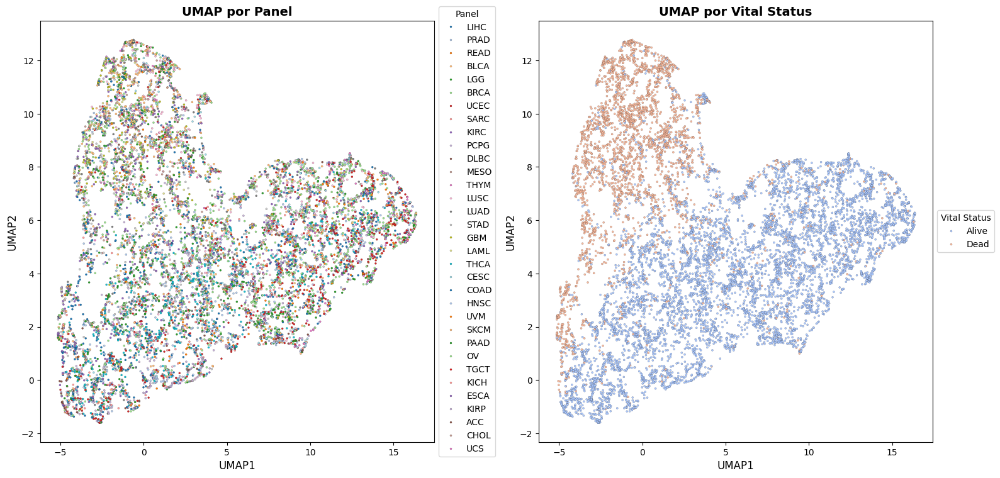

,UMAP1,UMAP2,index,vital,panel_y
0,2.949628,0.168477,9fe7d0f4-866d-490f-b2cb-d9be7da889de,Alive,LIHC
1,7.888754,2.615545,dd74434f-300f-4798-8342-aad31b192e12,Alive,PRAD
2,3.450796,10.653480,07db9e9d-059d-4e6c-b483-81517a492b96,Dead,READ
3,-0.024213,0.101666,47ee860a-fd18-48f2-bfe7-4e19391950bd,Alive,LIHC
4,-0.297556,11.776370,e322b0e5-458a-4cbf-a64f-9b348e413939,Dead,BLCA
...,...,...,...,...,...
10281,0.879515,9.662340,62cb41b1-8960-4fa2-8f74-38dd174af004,Dead,KIRC
10282,5.503684,4.114653,673a85f3-ba5e-448a-acee-dfec77b5238e,Alive,UCS
10283,1.009896,1.104327,3d93b2ae-7730-4914-af23-ff3554752922,Alive,LGG
10284,2.562092,6.713937,85a0b88f-2b89-4117-9e04-b81fad7f2e1b,Alive,LAML


In [21]:
df_coords = process_model_and_umap(df, epoch_to_load=100, layer_of_interest='label_predictor.fc2', device='cuda')

df_coords

<ipython-input-20-ede5ccc788ef>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 1 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |   

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


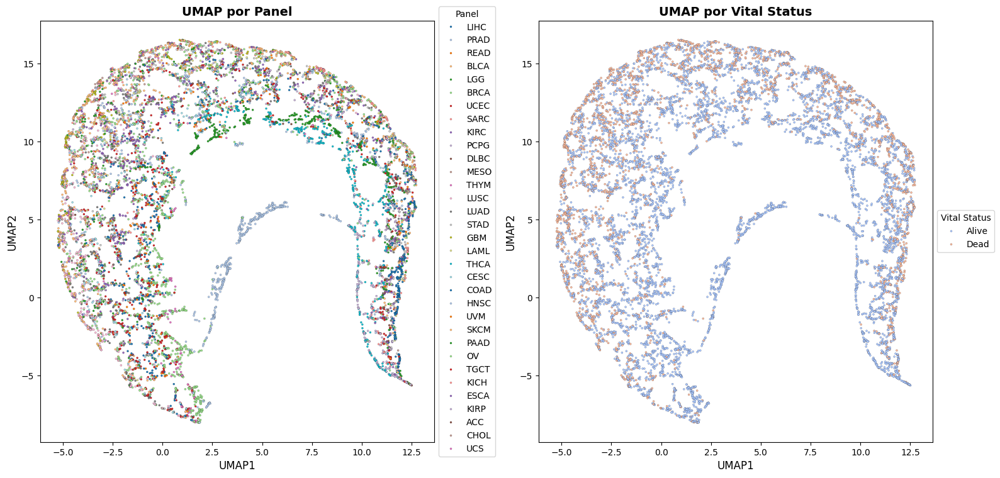

<ipython-input-20-ede5ccc788ef>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 10 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


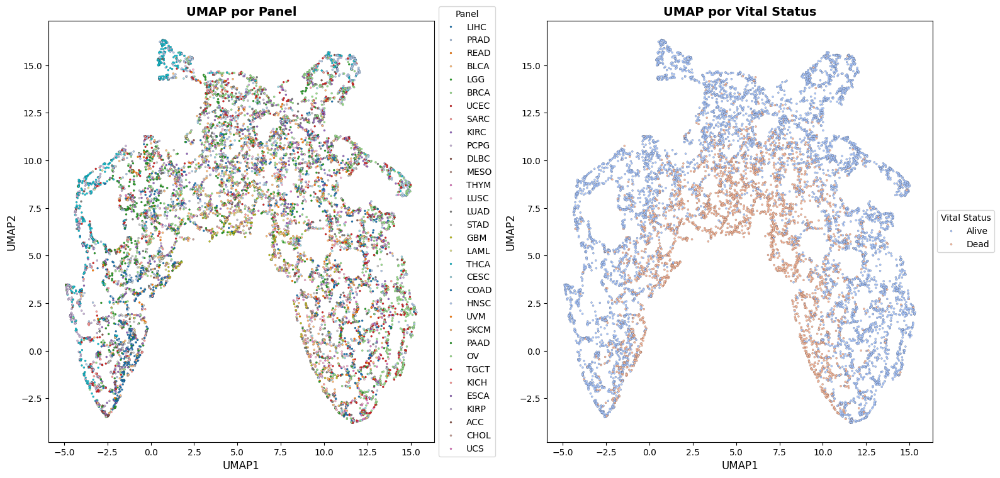

<ipython-input-20-ede5ccc788ef>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 30 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


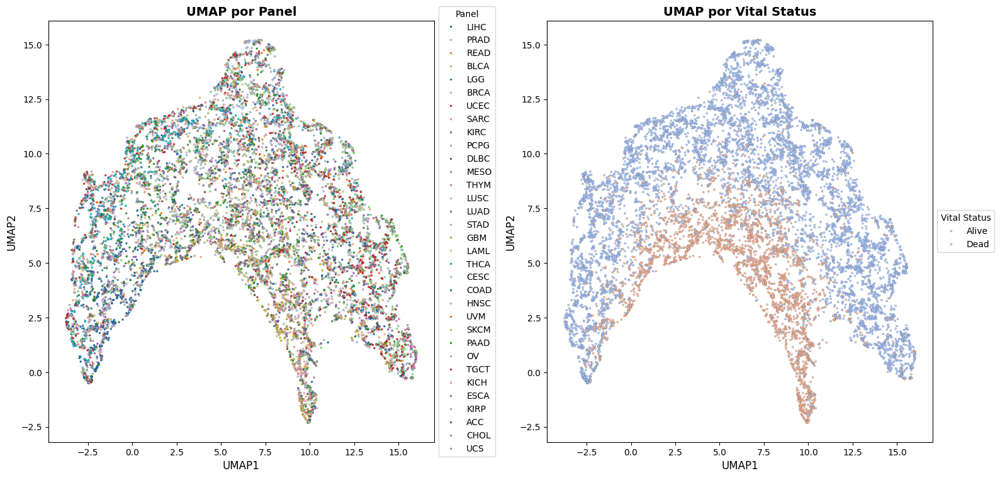

<ipython-input-20-ede5ccc788ef>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 50 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 |  

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


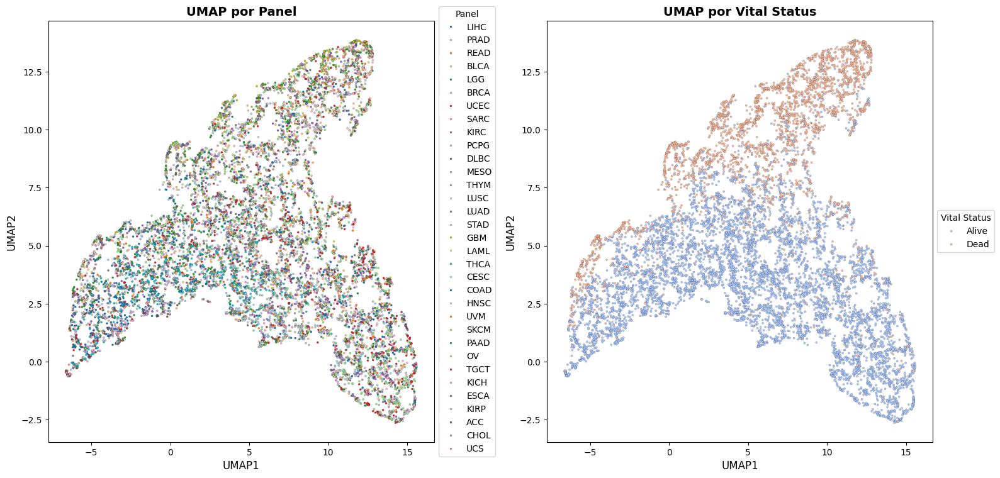

<ipython-input-20-ede5ccc788ef>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


Modelo de la época 100 cargado exitosamente.

+-----------------------+------------------+------------+
|   Nombre de la capa   |   Tipo de capa   | Parámetros |
+-----------------------+------------------+------------+
|                       |       DANN       |  44028034  |
|   feature_extractor   | FeatureExtractor |  39982000  |
| feature_extractor.fc1 |      Linear      |  39980000  |
| feature_extractor.bn1 |   BatchNorm1d    |    2000    |
|    label_predictor    |  LabelPredictor  |  2007001   |
|  label_predictor.fc1  |      Linear      |  1001000   |
|  label_predictor.bn1  |   BatchNorm1d    |    2000    |
|  label_predictor.fc2  |      Linear      |  1001000   |
|  label_predictor.bn2  |   BatchNorm1d    |    2000    |
|  label_predictor.fc3  |      Linear      |    1001    |
|   domain_classifier   | DomainClassifier |  2039033   |
| domain_classifier.fc1 |      Linear      |  1001000   |
| domain_classifier.bn1 |   BatchNorm1d    |    2000    |
| domain_classifier.fc2 | 

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


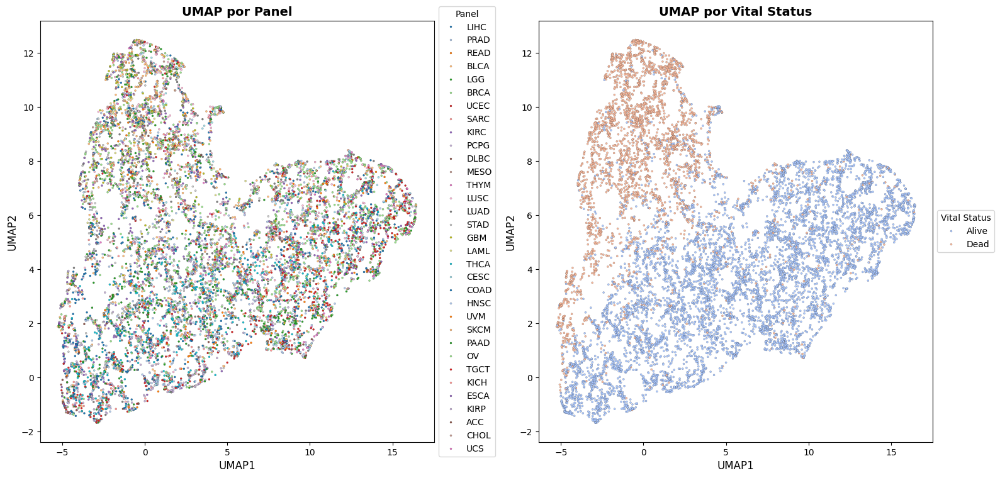

In [22]:
# Lista para guardar los DataFrames
dataframes_list = []

# Ciclo iterativo de 1 a 30
for i in [1,10,30,50,100]:#range(49, 50):
    df_coords = process_model_and_umap(df, epoch_to_load=i, layer_of_interest='label_predictor.fc2', device='cuda')
    df_coords['epochs'] = i
    dataframes_list.append(df_coords)

# Al final, la lista `dataframes_list` contendrá los DataFrames generados en cada iteración


In [23]:
final_df = pd.concat(dataframes_list, ignore_index=True)
final_df

,UMAP1,UMAP2,index,vital,panel_y,epochs
0,11.438554,3.493368,9fe7d0f4-866d-490f-b2cb-d9be7da889de,Alive,LIHC,1
1,3.908212,4.678157,dd74434f-300f-4798-8342-aad31b192e12,Alive,PRAD,1
2,-1.412351,-5.178170,07db9e9d-059d-4e6c-b483-81517a492b96,Dead,READ,1
3,11.803541,0.051224,47ee860a-fd18-48f2-bfe7-4e19391950bd,Alive,LIHC,1
4,-3.848242,-0.318737,e322b0e5-458a-4cbf-a64f-9b348e413939,Dead,BLCA,1
...,...,...,...,...,...,...
51425,1.237461,9.411751,62cb41b1-8960-4fa2-8f74-38dd174af004,Dead,KIRC,100
51426,5.761249,3.675491,673a85f3-ba5e-448a-acee-dfec77b5238e,Alive,UCS,100
51427,1.057600,0.790867,3d93b2ae-7730-4914-af23-ff3554752922,Alive,LGG,100
51428,2.945113,6.396350,85a0b88f-2b89-4117-9e04-b81fad7f2e1b,Alive,LAML,100


In [24]:
final_df[final_df['epochs'] == 100].set_index('index')

,UMAP1,UMAP2,vital,panel_y,epochs
index,,,,,
9fe7d0f4-866d-490f-b2cb-d9be7da889de,3.017829,-0.151815,Alive,LIHC,100
dd74434f-300f-4798-8342-aad31b192e12,8.227454,2.409149,Alive,PRAD,100
07db9e9d-059d-4e6c-b483-81517a492b96,4.127921,9.938430,Dead,READ,100
47ee860a-fd18-48f2-bfe7-4e19391950bd,0.076860,-0.110212,Alive,LIHC,100
e322b0e5-458a-4cbf-a64f-9b348e413939,0.145714,11.540321,Dead,BLCA,100
...,...,...,...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,1.237461,9.411751,Dead,KIRC,100
673a85f3-ba5e-448a-acee-dfec77b5238e,5.761249,3.675491,Alive,UCS,100
3d93b2ae-7730-4914-af23-ff3554752922,1.057600,0.790867,Alive,LGG,100


In [25]:
final_df.set_index("index")[['UMAP1','UMAP2']]

,UMAP1,UMAP2
index,,
9fe7d0f4-866d-490f-b2cb-d9be7da889de,11.438554,3.493368
dd74434f-300f-4798-8342-aad31b192e12,3.908212,4.678157
07db9e9d-059d-4e6c-b483-81517a492b96,-1.412351,-5.178170
47ee860a-fd18-48f2-bfe7-4e19391950bd,11.803541,0.051224
e322b0e5-458a-4cbf-a64f-9b348e413939,-3.848242,-0.318737
...,...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,1.237461,9.411751
673a85f3-ba5e-448a-acee-dfec77b5238e,5.761249,3.675491
3d93b2ae-7730-4914-af23-ff3554752922,1.057600,0.790867


In [26]:
df['VIM']

,VIM
9fe7d0f4-866d-490f-b2cb-d9be7da889de,0.450224
dd74434f-300f-4798-8342-aad31b192e12,2.407187
07db9e9d-059d-4e6c-b483-81517a492b96,3.087519
47ee860a-fd18-48f2-bfe7-4e19391950bd,0.137478
e322b0e5-458a-4cbf-a64f-9b348e413939,0.336692
...,...
62cb41b1-8960-4fa2-8f74-38dd174af004,24.294226
673a85f3-ba5e-448a-acee-dfec77b5238e,7.453442
3d93b2ae-7730-4914-af23-ff3554752922,0.451591
85a0b88f-2b89-4117-9e04-b81fad7f2e1b,11.153653


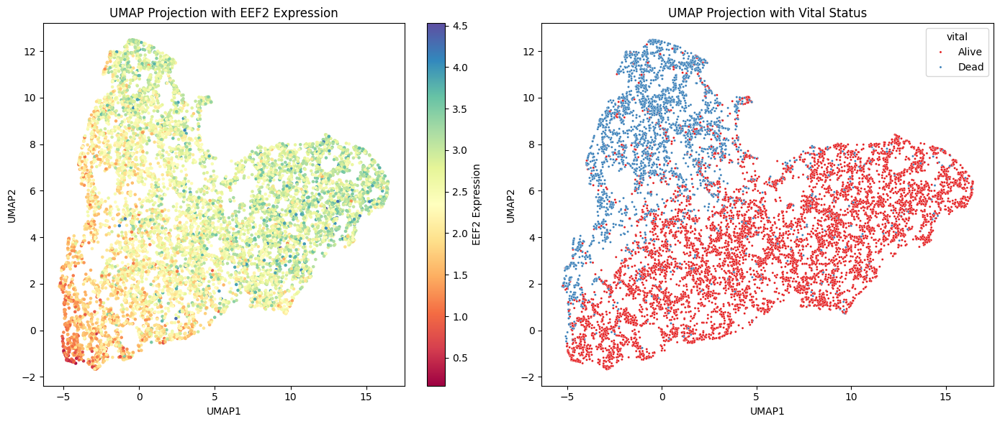

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt
import umap
import pandas as pd
import numpy as np  # Asegúrate de importar numpy

# Supongo que df es el DataFrame original, si no, ajusta este nombre
df_VIS = final_df[final_df['epochs'] == 100].set_index('index').copy()

# Añadir una columna log-transformada de 'EEF2'
df_VIS['EEF2'] = np.log(df['EEF2'] + 1)
df_VIS['vital'] = df['vital']  # Dejar 'vital' como string

# Crear una figura con dos subplots (1 fila, 2 columnas)
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Primera gráfica: UMAP con EEF2 como color
scatter1 = axes[0].scatter(
    x=df_VIS['UMAP1'],
    y=df_VIS['UMAP2'],
    c=df_VIS['EEF2'],
    cmap='Spectral',
    s=5
)
axes[0].set_title('UMAP Projection with EEF2 Expression')
axes[0].set_xlabel('UMAP1')
axes[0].set_ylabel('UMAP2')

# Añadir la barra de color para la primera gráfica
cbar1 = fig.colorbar(scatter1, ax=axes[0])
cbar1.set_label('EEF2 Expression')

# Segunda gráfica: UMAP con 'vital' como color categórico usando Seaborn
sns.scatterplot(
    x='UMAP1',
    y='UMAP2',
    hue='vital',
    palette='Set1',  # Puedes cambiar la paleta si lo prefieres
    data=df_VIS,
    ax=axes[1],
    s=5
)
axes[1].set_title('UMAP Projection with Vital Status')
axes[1].set_xlabel('UMAP1')
axes[1].set_ylabel('UMAP2')

# Mostrar ambas gráficas
plt.tight_layout()
plt.show()


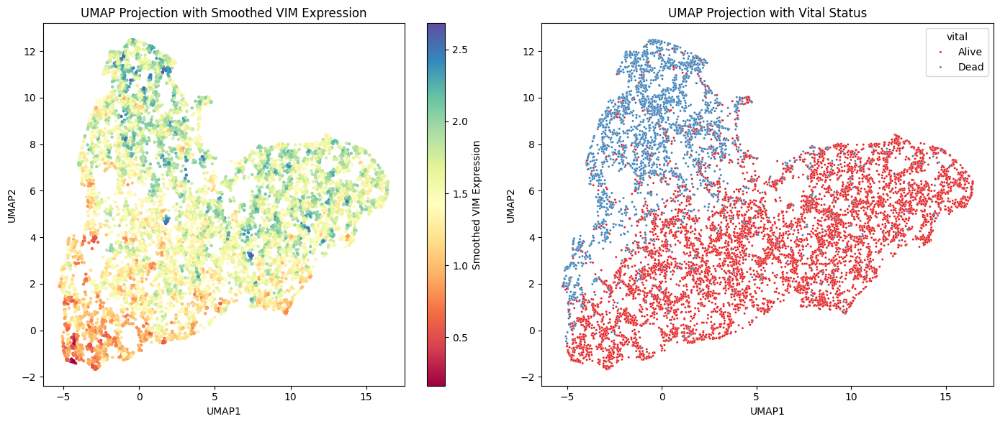

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt
import umap
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors  # Para calcular los vecinos más cercanos

# Variable para cambiar rápidamente el gen a visualizar
gene_to_plot = 'VIM'  # Cambia esto al gen que quieras visualizar

# Supongo que df es el DataFrame original, si no, ajusta este nombre
df_VIS = final_df[final_df['epochs'] == 100].set_index('index').copy()

# Añadir una columna log-transformada del gen seleccionado
df_VIS[gene_to_plot] = np.log(df[gene_to_plot] + 1)
df_VIS['vital'] = df['vital']  # Dejar 'vital' como string

# Obtener las coordenadas UMAP
coordinates = df_VIS[['UMAP1', 'UMAP2']].values

# Suavizado utilizando los vecinos más cercanos
n_neighbors = 10  # Número de vecinos para el suavizado
nbrs = NearestNeighbors(n_neighbors=n_neighbors).fit(coordinates)
distances, indices = nbrs.kneighbors(coordinates)

# Promediar la expresión génica de los vecinos más cercanos
smoothed_expression = np.zeros(df_VIS[gene_to_plot].shape)
for i, neighbors in enumerate(indices):
    smoothed_expression[i] = np.mean(df_VIS.iloc[neighbors][gene_to_plot])

# Asignar la expresión suavizada al DataFrame
df_VIS[f'{gene_to_plot}_smoothed'] = smoothed_expression

# Crear una figura con dos subplots (1 fila, 2 columnas)
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Primera gráfica: UMAP con la expresión suavizada del gen seleccionado
scatter1 = axes[0].scatter(
    x=df_VIS['UMAP1'],
    y=df_VIS['UMAP2'],
    c=df_VIS[f'{gene_to_plot}_smoothed'],
    cmap='Spectral',
    s=5
)
axes[0].set_title(f'UMAP Projection with Smoothed {gene_to_plot} Expression')
axes[0].set_xlabel('UMAP1')
axes[0].set_ylabel('UMAP2')

# Añadir la barra de color para la primera gráfica
cbar1 = fig.colorbar(scatter1, ax=axes[0])
cbar1.set_label(f'Smoothed {gene_to_plot} Expression')

# Segunda gráfica: UMAP con 'vital' como color categórico usando Seaborn
sns.scatterplot(
    x='UMAP1',
    y='UMAP2',
    hue='vital',
    palette='Set1',  # Puedes cambiar la paleta si lo prefieres
    data=df_VIS,
    ax=axes[1],
    s=5
)
axes[1].set_title('UMAP Projection with Vital Status')
axes[1].set_xlabel('UMAP1')
axes[1].set_ylabel('UMAP2')

# Mostrar ambas gráficas
plt.tight_layout()
plt.show()


In [29]:
import seaborn as sns
import matplotlib.pyplot as plt
import umap
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors  # Para calcular los vecinos más cercanos

def plot_umap_with_gene_expression(df, df_VIS, gene_to_plot, smooth=False, n_neighbors=10):
    """
    Función para graficar proyecciones UMAP con la expresión génica, con opción de suavizado.

    Parameters:
    - df: DataFrame con las expresiones génicas (original).
    - df_VIS: DataFrame con las coordenadas UMAP y otros datos.
    - gene_to_plot: String con el nombre del gen a visualizar.
    - smooth: Booleano que indica si se aplica suavizado a la expresión génica (por vecinos cercanos).
    - n_neighbors: Número de vecinos cercanos para el suavizado.
    """

    # Verificar si la columna del gen está en el DataFrame original
    if gene_to_plot not in df.columns:
        raise KeyError(f"Error: La columna '{gene_to_plot}' no existe en el DataFrame 'df'.")

    # Añadir una columna log-transformada del gen seleccionado al DataFrame de visualización (df_VIS)
    df_VIS[gene_to_plot] = np.log(df[gene_to_plot] + 1)  # Tomar la columna del df original
    df_VIS['vital'] = df['vital']  # Asegurarse de que la columna 'vital' también esté en df_VIS

    # Obtener las coordenadas UMAP de df_VIS
    coordinates = df_VIS[['UMAP1', 'UMAP2']].values

    # Si se selecciona suavizado
    if smooth:
        nbrs = NearestNeighbors(n_neighbors=n_neighbors).fit(coordinates)
        distances, indices = nbrs.kneighbors(coordinates)

        # Promediar la expresión génica de los vecinos más cercanos
        smoothed_expression = np.zeros(df_VIS[gene_to_plot].shape)
        for i, neighbors in enumerate(indices):
            smoothed_expression[i] = np.mean(df_VIS.iloc[neighbors][gene_to_plot])
        df_VIS[f'{gene_to_plot}_smoothed'] = smoothed_expression
        expression_column = f'{gene_to_plot}_smoothed'
    else:
        expression_column = gene_to_plot

    # Crear una figura con dos subplots (1 fila, 2 columnas)
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # Primera gráfica: UMAP con la expresión del gen seleccionado (suavizada o no)
    scatter1 = axes[0].scatter(
        x=df_VIS['UMAP1'],
        y=df_VIS['UMAP2'],
        c=df_VIS[expression_column],
        cmap='Spectral',
        s=5
    )
    axes[0].set_title(f'UMAP Projection with {expression_column} Expression')
    axes[0].set_xlabel('UMAP1')
    axes[0].set_ylabel('UMAP2')

    # Añadir la barra de color para la primera gráfica
    cbar1 = fig.colorbar(scatter1, ax=axes[0])
    cbar1.set_label(f'{expression_column} Expression')

    # Segunda gráfica: UMAP con 'vital' como color categórico usando Seaborn
    sns.scatterplot(
        x='UMAP1',
        y='UMAP2',
        hue='vital',
        palette='Set1',  # Puedes cambiar la paleta si lo prefieres
        data=df_VIS,
        ax=axes[1],
        s=5
    )
    axes[1].set_title('UMAP Projection with Vital Status')
    axes[1].set_xlabel('UMAP1')
    axes[1].set_ylabel('UMAP2')

    # Mostrar ambas gráficas
    plt.tight_layout()
    plt.show()



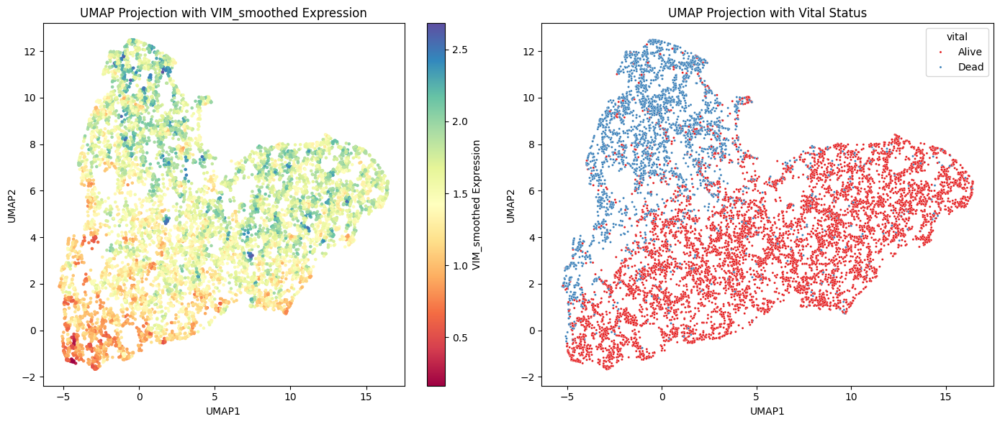

In [30]:
# Supongo que df es el DataFrame original con las expresiones génicas
# y df_VIS contiene las coordenadas UMAP y otras variables
df_VIS = final_df[final_df['epochs'] == 100].set_index('index').copy()

# Llamar a la función con ambos DataFrames y suavizado o sin suavizado
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='VIM', smooth=True, n_neighbors=10)


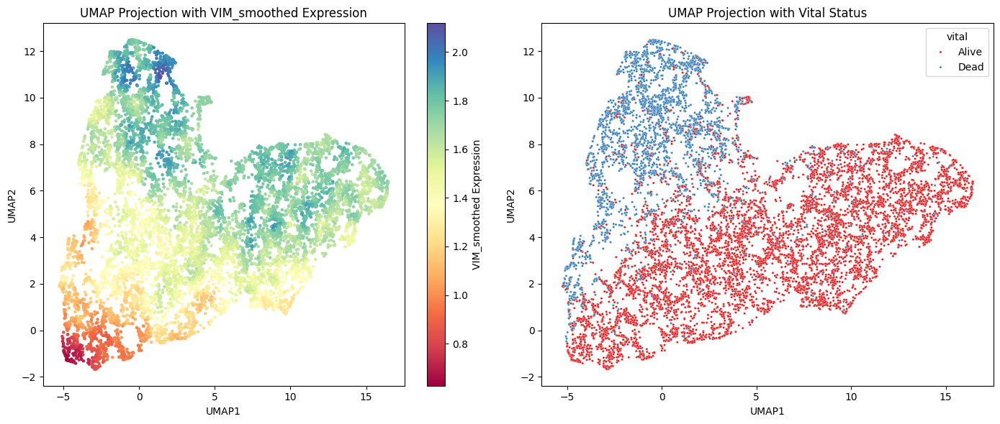

In [31]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='VIM', smooth=True, n_neighbors=100)


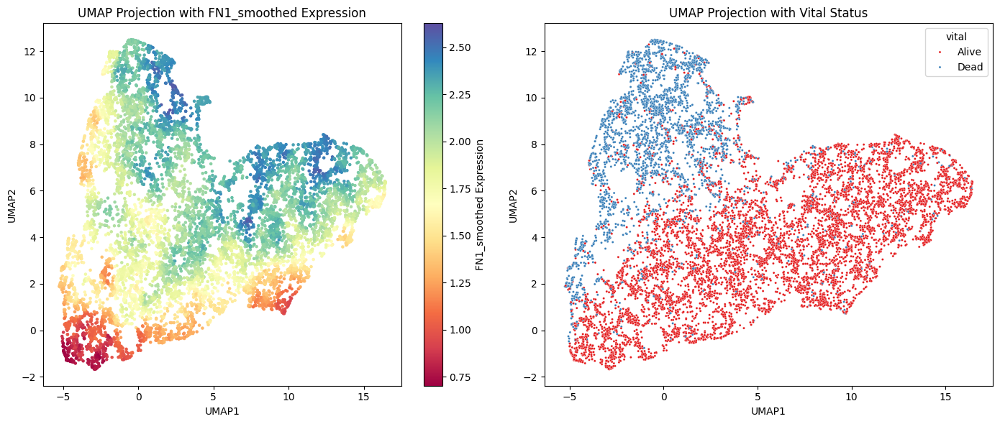

In [32]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='FN1', smooth=True, n_neighbors=100)


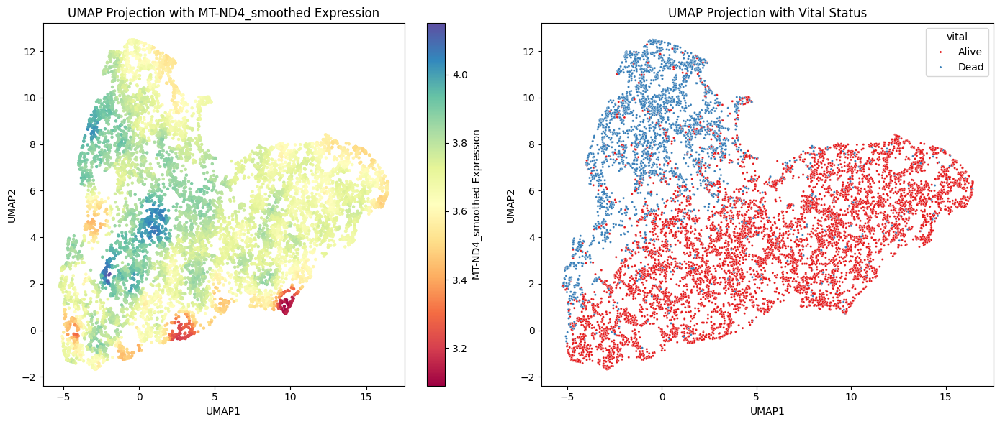

In [33]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='MT-ND4', smooth=True, n_neighbors=100)


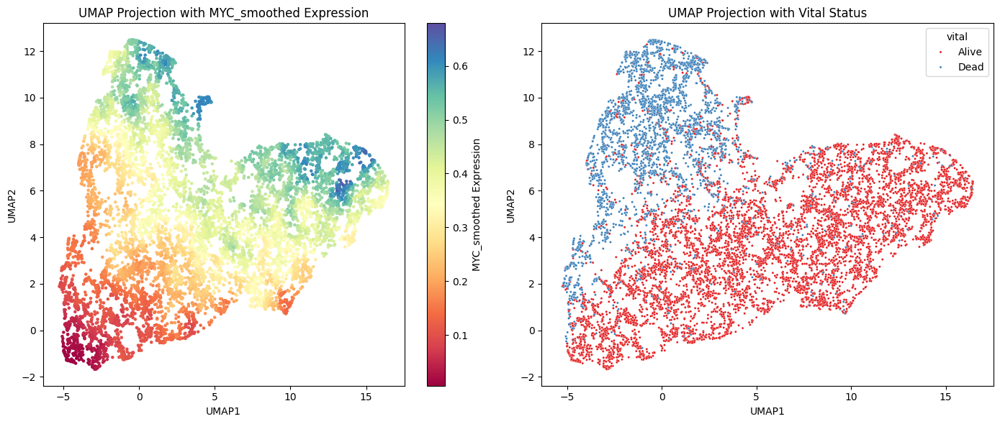

In [34]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='MYC', smooth=True, n_neighbors=100)


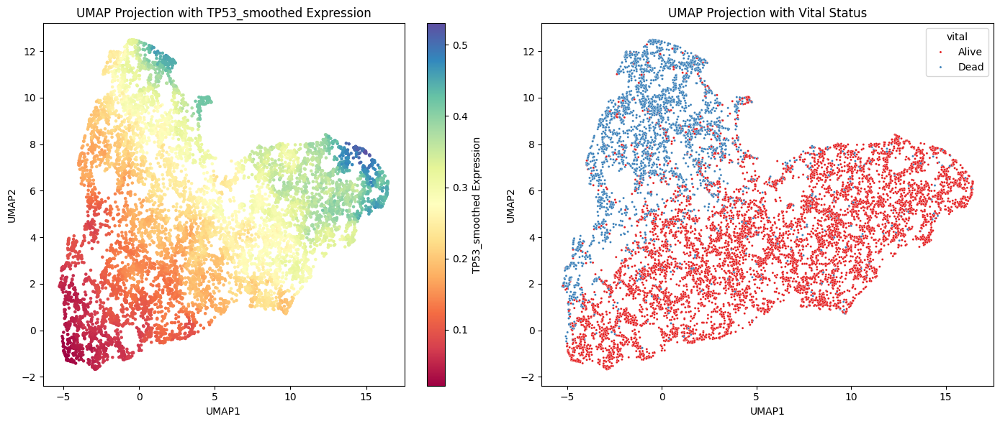

In [35]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='TP53', smooth=True, n_neighbors=100)


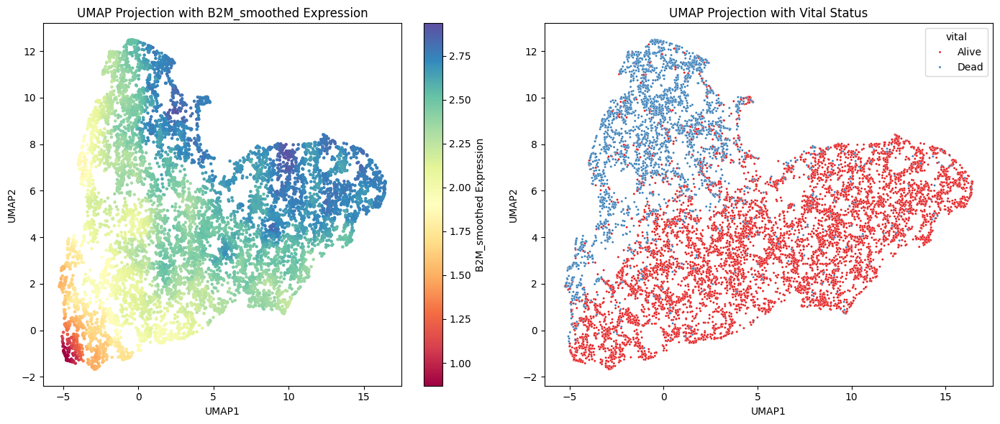

In [36]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='B2M', smooth=True, n_neighbors=100)


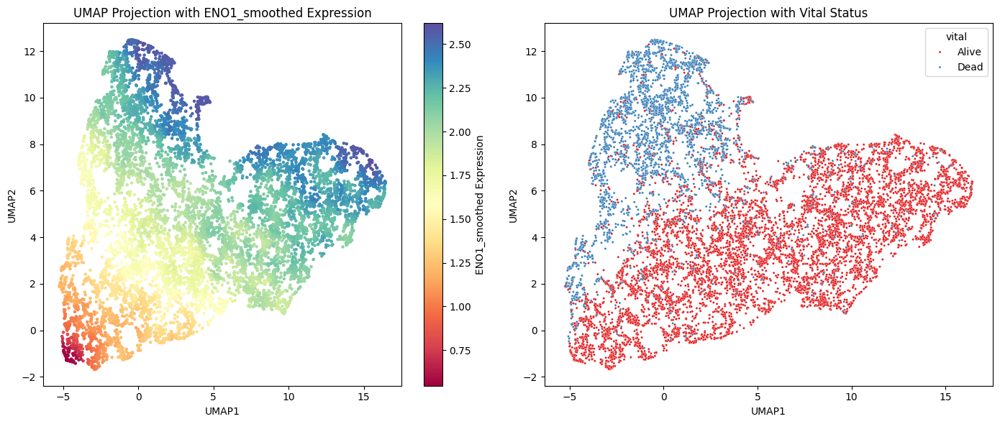

In [37]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='ENO1', smooth=True, n_neighbors=100)


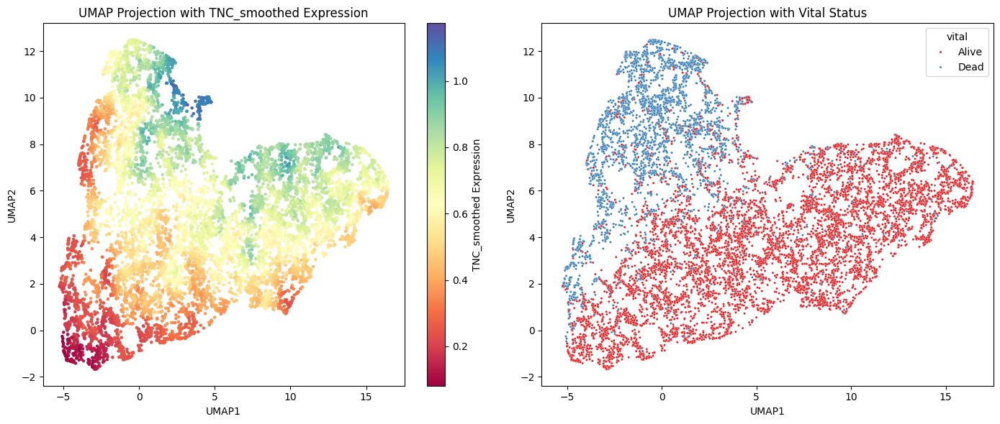

In [38]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='TNC', smooth=True, n_neighbors=100)


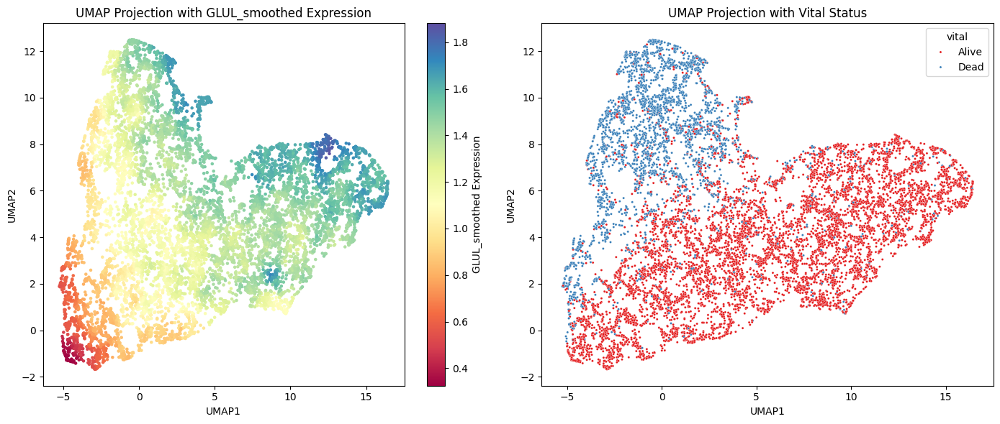

In [39]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='GLUL', smooth=True, n_neighbors=100)


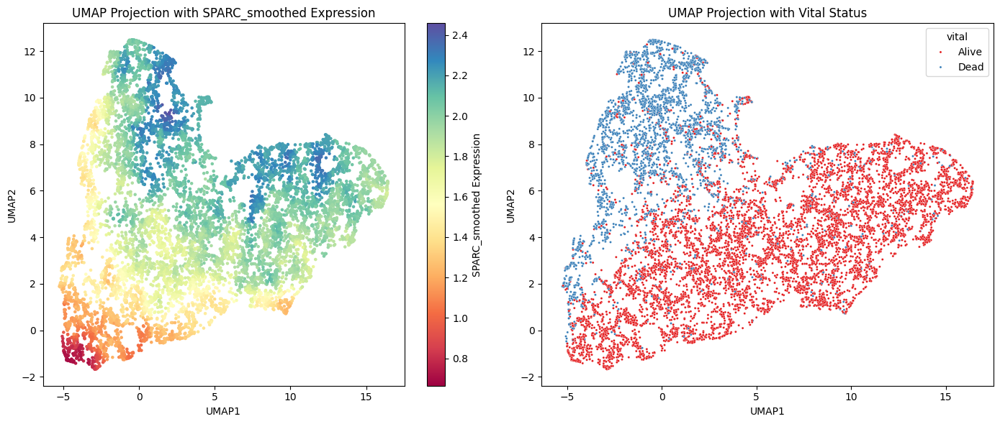

In [40]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='SPARC', smooth=True, n_neighbors=100)


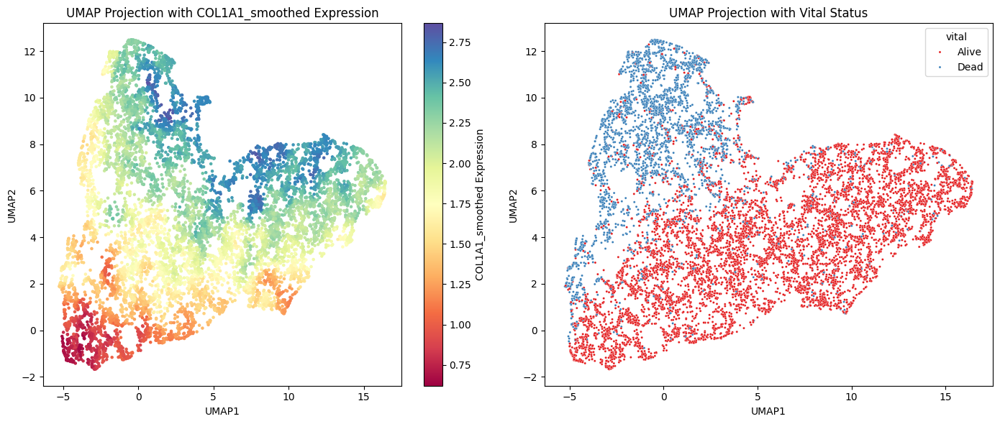

In [41]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='COL1A1', smooth=True, n_neighbors=100)


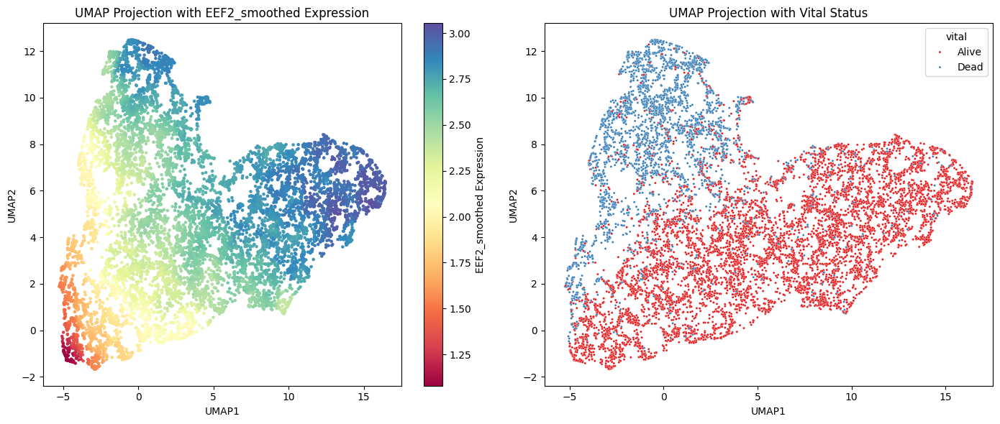

In [42]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='EEF2', smooth=True, n_neighbors=100)


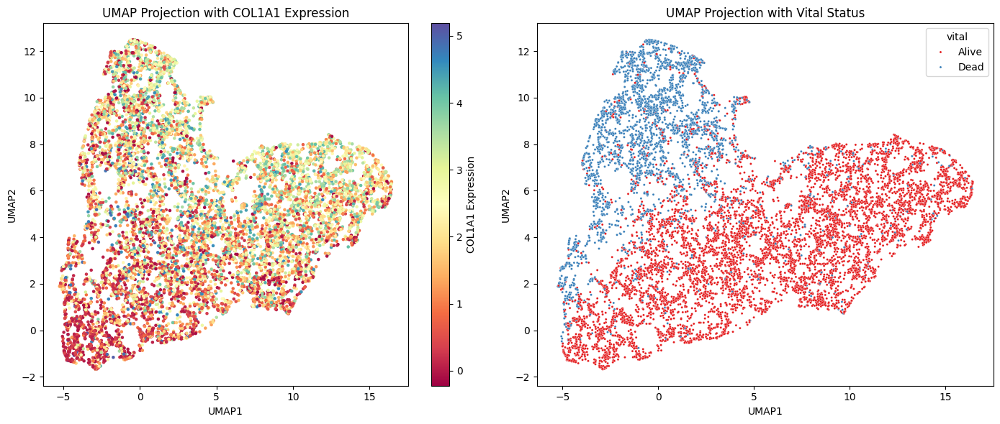

In [43]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='COL1A1', smooth=False, n_neighbors=100)


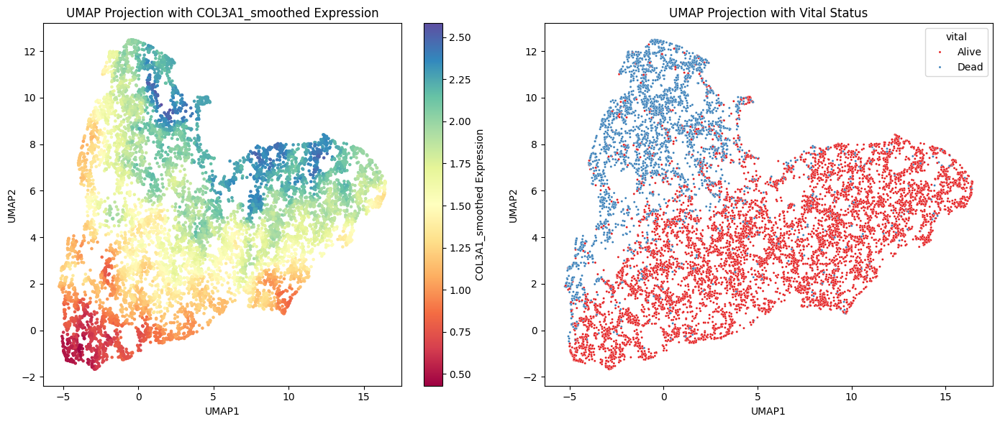

In [44]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='COL3A1', smooth=True, n_neighbors=100)


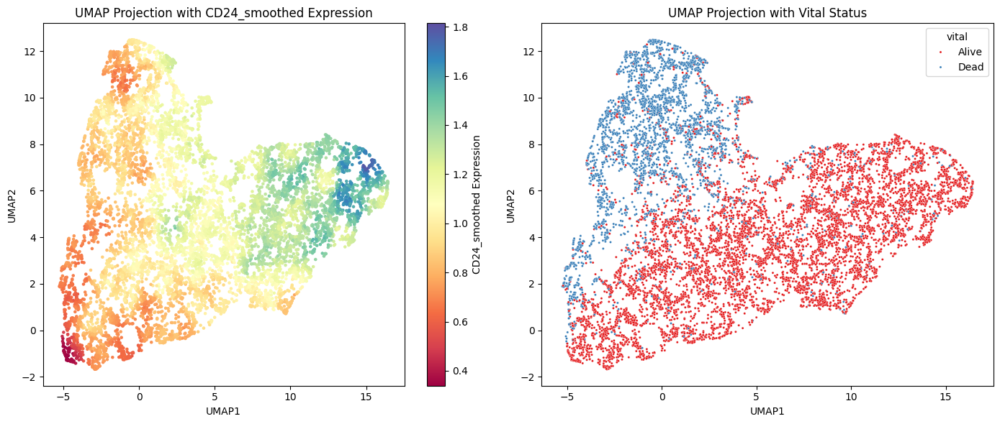

In [45]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='CD24', smooth=True, n_neighbors=100)


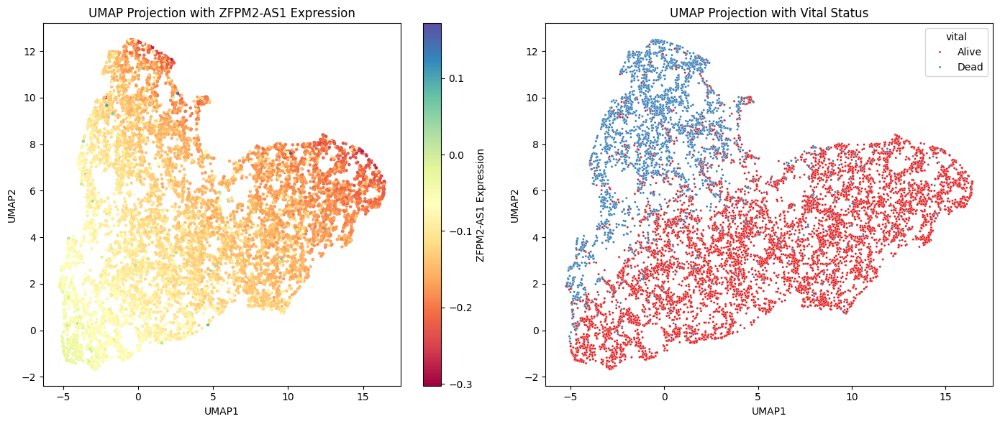

In [46]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='ZFPM2-AS1', smooth=False, n_neighbors=100)


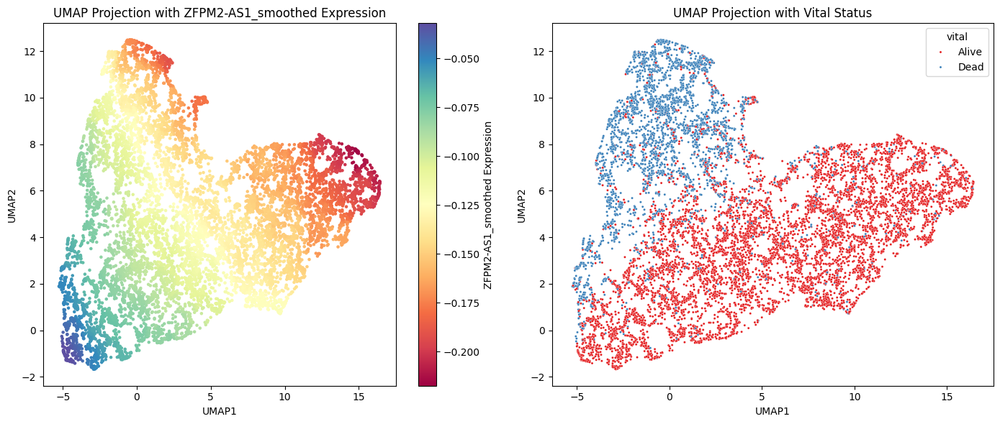

In [47]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='ZFPM2-AS1', smooth=True, n_neighbors=100)


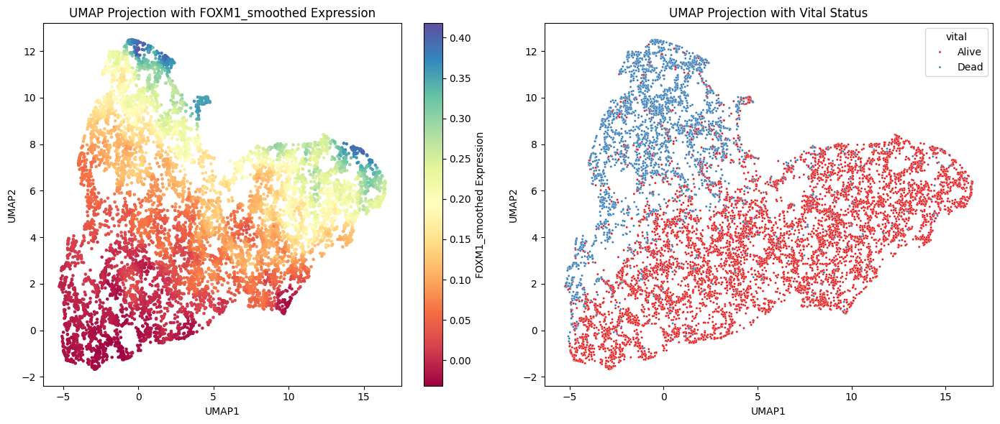

In [48]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='FOXM1', smooth=True, n_neighbors=100)


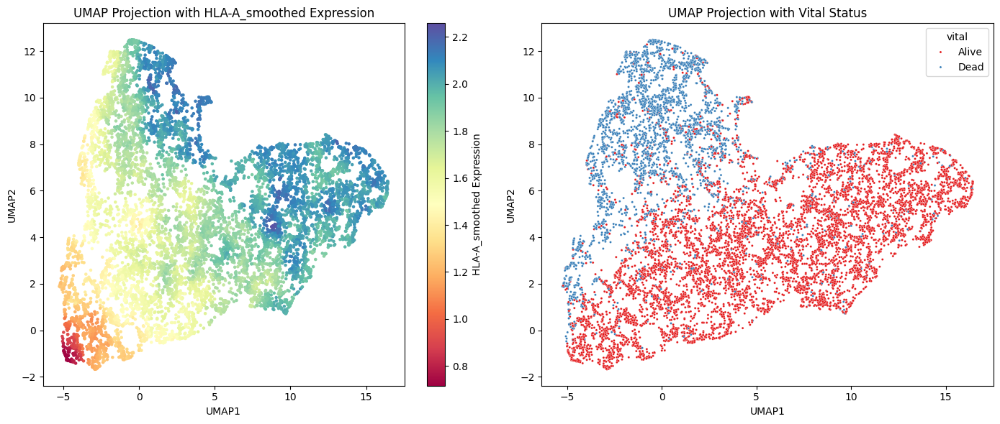

In [49]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='HLA-A', smooth=True, n_neighbors=100)

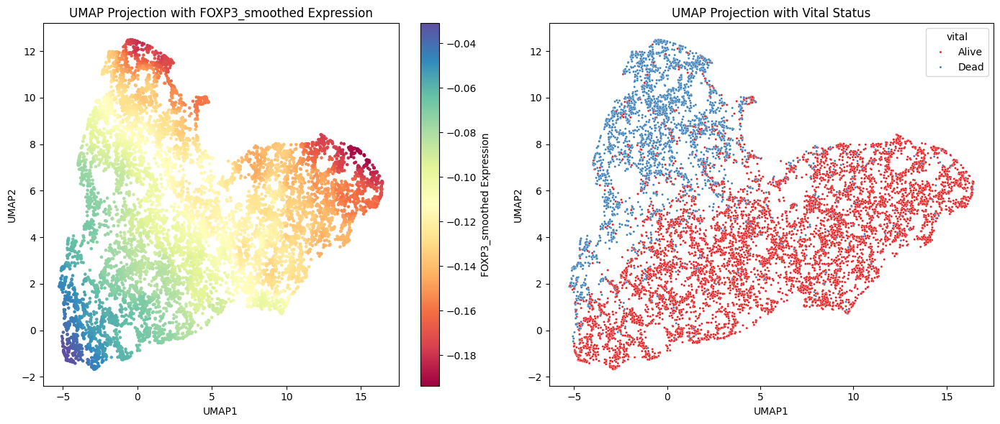

In [50]:
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='FOXP3', smooth=True, n_neighbors=100)

SHAP VALUES


In [51]:
import os
import torch
import pandas as pd
from torch.utils.data import DataLoader, TensorDataset
from sklearn.preprocessing import LabelEncoder

def process_model_and_data(df, epoch_to_load, device='cpu', batch_size=128):
    # Preparar los datos del DataFrame
    X = df.iloc[:, :-2].values  # Datos de las características (miRNAs u otras variables)
    Y = df['vital'].replace({'Alive': 1, 'Dead': 0}).values  # Estado vital (Alive = 1, Dead = 0)
    panels = df['panel'].values  # Etiquetas del dominio (paneles)

    # Convertir la columna 'panel' a valores numéricos usando LabelEncoder
    label_encoder_panel = LabelEncoder()
    panels = label_encoder_panel.fit_transform(panels)

    # Convertir los datos en tensores para PyTorch
    X_tensor = torch.tensor(X, dtype=torch.float32).to(device)
    Y_tensor = torch.tensor(Y, dtype=torch.float32).unsqueeze(1).to(device)
    panels_tensor = torch.tensor(panels, dtype=torch.long).to(device)

    # Crear el DataLoader
    dataset = TensorDataset(X_tensor, Y_tensor, panels_tensor)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    # Cargar el modelo de la época deseada
    model_path = f'/content/model_checkpoints/model_epoch_{epoch_to_load}.pth'
    input_dim = X.shape[1]
    num_domains = len(label_encoder_panel.classes_)  # Número de paneles (dominios)

    # Definir la arquitectura del modelo DANN
    model = DANN(input_dim, num_domains).to(device)

    # Cargar los pesos del modelo
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.eval()  # Poner el modelo en modo de evaluación

    print(f"Modelo de la época {epoch_to_load} cargado exitosamente.")

    return model, loader

# Ejemplo de uso:
epoch_to_load = 50
device = 'cuda'  # O 'cpu', según tu entorno

# Suponiendo que ya tienes un DataFrame 'df' con las columnas necesarias
model, loader = process_model_and_data(df, epoch_to_load, device)


Modelo de la época 50 cargado exitosamente.


<ipython-input-51-aa9140218030>:35: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


In [52]:
model

DANN(
  (feature_extractor): FeatureExtractor(
    (fc1): Linear(in_features=39979, out_features=1000, bias=True)
    (bn1): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (dropout1): Dropout(p=0.1, inplace=False)
  )
  (label_predictor): LabelPredictor(
    (fc1): Linear(in_features=1000, out_features=1000, bias=True)
    (bn1): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (dropout1): Dropout(p=0.1, inplace=False)
    (fc2): Linear(in_features=1000, out_features=1000, bias=True)
    (bn2): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (dropout2): Dropout(p=0.1, inplace=False)
    (fc3): Linear(in_features=1000, out_features=1, bias=True)
  )
  (domain_classifier): DomainClassifier(
    (fc1): Linear(in_features=1000, out_features=1000, bias=True)
    (bn1): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (dropout1): Dropout(p=0.1

Calculating SHAP values: 100%|██████████| 100/100 [00:16<00:00,  6.05it/s]


Final SHAP values numpy array shape: (100, 39979)
Generating SHAP summary plot...


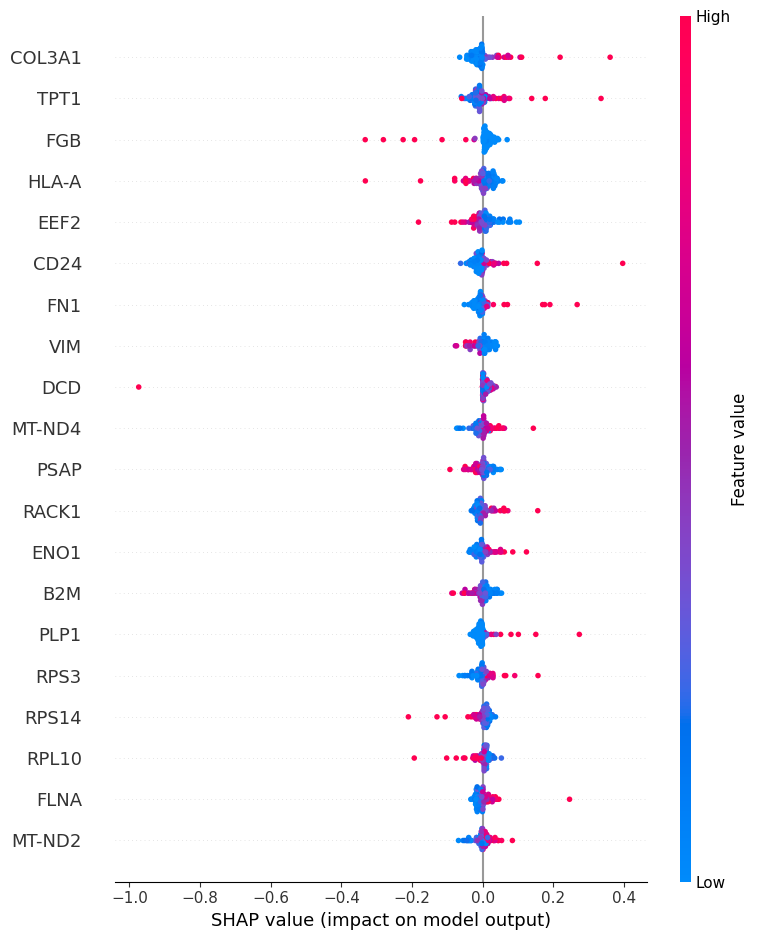

SHAP summary plot generated successfully.


In [54]:
import torch
import shap
from tqdm import tqdm
import numpy as np

# Ensure your model is on the correct device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Assume df is already defined and contains the miRNA data
X = df.iloc[:, :-2].values[:100]  # First 200 rows, all columns except the last two
X_tensor = torch.tensor(X, dtype=torch.float32).to(device)

# Ensure the model is in evaluation mode
model.eval()

# Define the combined model that includes the FeatureExtractor and LabelPredictor
class CombinedModel(torch.nn.Module):
    def __init__(self, feature_extractor, label_predictor):
        super(CombinedModel, self).__init__()
        self.feature_extractor = feature_extractor
        self.label_predictor = label_predictor

    def forward(self, x):
        # Pass through FeatureExtractor first
        features = self.feature_extractor(x)
        # Pass the extracted features through the LabelPredictor
        output = self.label_predictor(features)
        return output

# Create an instance of the combined model
combined_model = CombinedModel(model.feature_extractor, model.label_predictor).to(device)

# Create a SHAP GradientExplainer with the combined model and data
explainer = shap.GradientExplainer(combined_model, X_tensor)

# Calculate SHAP values for the instances in X_tensor
shap_values = []
try:
    for i in tqdm(range(X_tensor.shape[0]), desc="Calculating SHAP values"):
        shap_value = explainer.shap_values(X_tensor[i:i+1])
        shap_values.append(shap_value)

    # Convert SHAP values list to a numpy array
    shap_values_np = np.vstack(shap_values).squeeze()
    print("Final SHAP values numpy array shape:", shap_values_np.shape)

    # Use the original feature names
    feature_names_original = df.iloc[:, :-2].columns

    # Generate SHAP summary plot
    print("Generating SHAP summary plot...")
    shap.summary_plot(shap_values_np, X, feature_names=feature_names_original)
    print("SHAP summary plot generated successfully.")

except Exception as e:
    print(f"An error occurred: {e}")
    print(f"SHAP values calculated so far: {shap_values}")


In [ ]:
import pandas as pd
import numpy as np

# Supongamos que tu DataFrame de SHAP values es:
shap_df = pd.DataFrame(shap_values_np, columns=feature_names_original, index=df.index)
shap_df

In [ ]:
df['panel']

In [ ]:
import pandas as pd
import umap
import matplotlib.pyplot as plt
import seaborn as sns

# Asumiendo que shap_df es el DataFrame con los valores SHAP y df['panel'] contiene las etiquetas
# df['panel'] tiene las categorías que deseas visualizar

def generate_umap_with_labels(shap_df, panel_column, n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean'):
    # Crear el modelo UMAP
    umap_model = umap.UMAP(n_neighbors=n_neighbors,
                           min_dist=min_dist,
                           n_components=n_components,
                           metric=metric)

    # Ajustar UMAP a los valores SHAP
    umap_embedding = umap_model.fit_transform(shap_df)

    # Convertir el resultado de UMAP en un DataFrame para facilitar el análisis
    umap_df = pd.DataFrame(umap_embedding, columns=[f'UMAP_{i+1}' for i in range(n_components)], index=shap_df.index)

    # Agregar la columna 'panel' con las etiquetas de los diferentes cánceres
    umap_df['panel'] = panel_column

    # Visualización con colores basados en las categorías de 'panel'
    plt.figure(figsize=(12, 8))
    sns.scatterplot(x='UMAP_1', y='UMAP_2', hue='panel', data=umap_df, palette='tab10', alpha=0.8)
    plt.title('UMAP projection colored by cancer panel')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.legend(title='Cancer Panel', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

    return umap_df

# Supongamos que 'shap_df' es tu DataFrame de valores SHAP y 'df["panel"]' contiene las categorías
umap_result = generate_umap_with_labels(shap_df, df['panel'])

# Mostrar el resultado del UMAP con etiquetas
print(umap_result)


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import umap
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors  # Para calcular los vecinos más cercanos
def plot_umap_with_gene_expression(df, df_VIS, gene_to_plot, smooth=False, n_neighbors=10, n_pca_components=50):
    """
    Función para graficar proyecciones UMAP con la expresión génica, con opción de suavizado.

    Parameters:
    - df: DataFrame con las expresiones génicas (original).
    - df_VIS: DataFrame con las coordenadas UMAP y otros datos.
    - gene_to_plot: String con el nombre del gen a visualizar.
    - smooth: Booleano que indica si se aplica suavizado a la expresión génica (por vecinos cercanos).
    - n_neighbors: Número de vecinos cercanos para el suavizado.
    - n_pca_components: Número de componentes principales a usar en PCA antes de UMAP.
    """

    # Verificar si la columna del gen está en el DataFrame original
    if gene_to_plot not in df.columns:
        raise KeyError(f"Error: La columna '{gene_to_plot}' no existe en el DataFrame 'df'.")

    # Excluir columnas no numéricas (como 'vital') para PCA y UMAP
    numeric_df = df.select_dtypes(include=[np.number])

    # Paso 1: Aplicar PCA a los datos numéricos antes de UMAP
    pca = PCA(n_components=n_pca_components)
    pca_result = pca.fit_transform(numeric_df)

    # Paso 2: Aplicar UMAP a los datos transformados por PCA
    reducer = umap.UMAP()
    umap_embedding = reducer.fit_transform(pca_result)

    # Actualizar el DataFrame de visualización con las nuevas coordenadas UMAP
    df_VIS['UMAP1'] = umap_embedding[:, 0]
    df_VIS['UMAP2'] = umap_embedding[:, 1]

    # Añadir una columna log-transformada del gen seleccionado al DataFrame de visualización (df_VIS)
    df_VIS[gene_to_plot] = np.log(df[gene_to_plot] + 1)  # Tomar la columna del df original
    df_VIS['vital'] = df['vital']  # Asegurarse de que la columna 'vital' también esté en df_VIS

    # Obtener las coordenadas UMAP de df_VIS
    coordinates = df_VIS[['UMAP1', 'UMAP2']].values

    # Si se selecciona suavizado
    if smooth:
        nbrs = NearestNeighbors(n_neighbors=n_neighbors).fit(coordinates)
        distances, indices = nbrs.kneighbors(coordinates)

        # Promediar la expresión génica de los vecinos más cercanos
        smoothed_expression = np.zeros(df_VIS[gene_to_plot].shape)
        for i, neighbors in enumerate(indices):
            smoothed_expression[i] = np.mean(df_VIS.iloc[neighbors][gene_to_plot])
        df_VIS[f'{gene_to_plot}_smoothed'] = smoothed_expression
        expression_column = f'{gene_to_plot}_smoothed'
    else:
        expression_column = gene_to_plot

    # Crear una figura con dos subplots (1 fila, 2 columnas)
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # Primera gráfica: UMAP con la expresión del gen seleccionado (suavizada o no)
    scatter1 = axes[0].scatter(
        x=df_VIS['UMAP1'],
        y=df_VIS['UMAP2'],
        c=df_VIS[expression_column],
        cmap='Spectral',
        s=5
    )
    axes[0].set_title(f'UMAP Projection with {expression_column} Expression')
    axes[0].set_xlabel('UMAP1')
    axes[0].set_ylabel('UMAP2')

    # Añadir la barra de color para la primera gráfica
    cbar1 = fig.colorbar(scatter1, ax=axes[0])
    cbar1.set_label(f'{expression_column} Expression')

    # Segunda gráfica: UMAP con 'vital' como color categórico usando Seaborn
    sns.scatterplot(
        x='UMAP1',
        y='UMAP2',
        hue='vital',
        palette='Set1',  # Puedes cambiar la paleta si lo prefieres
        data=df_VIS,
        ax=axes[1],
        s=5
    )
    axes[1].set_title('UMAP Projection with Vital Status')
    axes[1].set_xlabel('UMAP1')
    axes[1].set_ylabel('UMAP2')

    # Mostrar ambas gráficas
    plt.tight_layout()
    plt.show()

# Supongo que df es el DataFrame original con las expresiones génicas
# y df_VIS contiene las coordenadas UMAP y otras variables
df_VIS = final_df[final_df['epochs'] == 29].set_index('index').copy()

# Llamar a la función con ambos DataFrames y suavizado o sin suavizado
plot_umap_with_gene_expression(df, df_VIS, gene_to_plot='VIM', smooth=True, n_neighbors=40, n_pca_components=50)


In [ ]:
df_VIS